In [1]:
#!/usr/bin/env python
# -*- coding: utf-8 -*-
# ***********************************
# Version: 0.1.1                    #
# Author:  rongboshen               #
# Email:   rongboshen2019@gmail.com #
# Date:    2023.10.25               #
# ***********************************

import os
import numpy as np
import pandas as pd
import pickle
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
import matplotlib.pyplot as plt
import scipy.stats as st
from sklearn.metrics import mean_squared_error
from skimage.metrics import structural_similarity as ssim
from scipy.spatial import distance
import json
import argparse
import scanpy as sc
from scipy import stats
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
def draw_violin(df, my_pal, save_dir, name, ylabel='Spearman Correlation'):
    fig, ax = plt.subplots(figsize=(20,16))
    sns.axes_style('darkgrid', {'grid.linestyle': '-'})
    ax = sns.violinplot(data=df, ax=ax, palette=my_pal)
    #ax = sns.boxplot(data=df, ax=ax)
    ax.set_ylabel(ylabel, fontsize=20)
    ax.tick_params(axis='x', labelsize=20)
    ax.tick_params(axis='y', labelsize=20)

    fig.savefig(os.path.join(save_dir, '%s_violin.pdf'%name), bbox_inches='tight')
    plt.close()

def draw_box(df, my_pal, save_dir, name, ylabel='Spearman Correlation'):
    fig, ax = plt.subplots(figsize=(20,16))
    sns.axes_style('darkgrid', {'grid.linestyle': '-'})
    ax = sns.boxplot(data=df, ax=ax, palette=my_pal)
    ax.set_ylabel(ylabel, fontsize=20)
    ax.tick_params(axis='x', labelsize=20)
    ax.tick_params(axis='y', labelsize=20)

    fig.savefig(os.path.join(save_dir, '%s_box.pdf'%name), bbox_inches='tight')
    plt.close()

def horizontal(array, height=0):
    horizonx = array[:,0]
    horizony = height - array[:,1]
    return np.stack((horizonx, horizony),axis=1)

def verizontal(array, width=0):
    verizonx = width - array[:,0]
    verizony = array[:,1]
    return np.stack((verizonx, verizony),axis=1)

def rotate(array, angle):
    rotatex = math.cos(angle)*array[:,0] - math.sin(angle)*array[:,1]
    rotatey = math.cos(angle)*array[:,1] + math.sin(angle)*array[:,0]
    return np.stack((rotatex, rotatey),axis=1)

def alignment(array):
    minx, maxx, miny, maxy = np.min(array[:,0]), np.max(array[:,0]), np.min(array[:,1]), np.max(array[:,1])
    return array - np.array([minx, miny]), maxx-minx, maxy-miny


def reorder(adata, subname):
    nindex = np.argsort(adata.obs[subname])[::-1]
    adata_reorder = adata[nindex,:]
    return adata_reorder

def draw_visual_genes(adata, slice, selected_genes, save_dir, method):
    sc.settings.figdir = save_dir
    demo_adata = adata[adata.obs.Bregma==slice,:]
    demo_adata.obsm['spatial'] = demo_adata.obsm['spatial'][:,:-1]
 
    coords = demo_adata.obsm['spatial']
    _coords, _, _ =  alignment(coords)
    demo_adata.obsm['spatial'] ,_ ,_ = alignment(verizontal(horizontal(_coords)))

    for gene in selected_genes:
        sc.pl.spatial(demo_adata, img_key=None, color=gene, spot_size=15, color_map='viridis', colorbar_loc=None, legend_fontsize='large', save="%s_%.2f_%s.pdf"%(method, slice, gene))

def renames(x):
    tmp = []
    for i in x:
        if i[1:].startswith('mt'):
            tmp.append(i[1:].replace('mt','mt-'))
        elif i[1:].startswith('RP23'):
            tmp.append(i[1:].replace('RP23','RP23-'))
        else:
            tmp.append(i[1:])
    return tmp 

def renames2(x):
    tmp = []
    for i in x:
        if i.startswith('mt'):
            tmp.append(i.replace('mt','mt-'))
        elif i.startswith('RP23'):
            tmp.append(i.replace('RP23','RP23-'))
        else:
            tmp.append(i)
    return tmp 


def calculate_scc_rmse(gene_order, name, ori_df, pred_df):
    _SCC = pd.Series(index = gene_order, dtype='float16', name=name)
    for i in gene_order:
        if np.std(pred_df[i]) == 0:
            _SCC[i] = 0
        else:
            _SCC[i] = st.spearmanr(ori_df[i], pred_df[i])[0]
    _RMSE = mean_squared_error(ori_df.to_numpy(), pred_df.to_numpy())
    print('===> %s median SCC and RMSE: %.4f, %.4f'%(name, _SCC.median(), _RMSE))
    return  _SCC,  _RMSE

def calculate_scc_rmse2(gene_order, name, ori_df, pred_df):
    _SCC = pd.Series(index = gene_order, dtype='float16', name=name)
    for i in gene_order:
        _SCC[i] = st.spearmanr(ori_df[i], pred_df[i])[0]
    _RMSE = mean_squared_error(ori_df.to_numpy(), pred_df.to_numpy())
    print('===> Note: without NA %s median SCC and RMSE: %.4f, %.4f'%(name, _SCC.median(), _RMSE))
    return  _SCC,  _RMSE

def draw_axs_spatial_genes(ax, expression_values, x_locs, y_locs, method, ms, gene):

    ax.set_aspect(1)
    vmin = np.percentile(expression_values, 1)
    vmax = np.percentile(expression_values, 99)

    tmp = sorted(list(zip(expression_values,x_locs,y_locs)))
    expression_values, x_locs, y_locs = list(zip(*tmp))

    sca = ax.scatter(x=x_locs, y=y_locs, s=ms, c=expression_values, vmin=vmin, vmax=vmax, cmap='jet', edgecolors='none')

    for sp in ax.spines.values():
        sp.set_visible(False)

    ax.set_xticks([])
    ax.set_yticks([])
    if gene: ax.set_ylabel(gene, fontsize=40, labelpad=10)
    if method: ax.set_title(method, fontsize=40, pad=10)
    return sca, vmin, vmax

def draw_visual_genes_mop(adata, imputed_dfs, sub_save_dir):
    #### Visual SpaGDA imputation result in spatial
    selected_genes = ['Rspo1','Otof','Syt6']
    methods = ['SpaGDA','Tangram','stPlus','SpaGE','gimVI','Seurat','MNN','Liger']

    slices = list(set(adata.obs.slice_id))
    slices.sort()
    print("All slices:", slices)
    #load the imputed gene values
    GT_adata = adata[:,selected_genes]
    all_visual_genes_df = pd.DataFrame(GT_adata.X, index=GT_adata.obs_names.to_list(), columns=GT_adata.var_names.to_list())

    for i, method in enumerate(methods):
        all_visual_genes_df[[method+'_'+j for j in selected_genes]] = np.array(imputed_dfs[i][selected_genes])

    all_visual_genes_df[['x','y']] = np.array(GT_adata.obsm['spatial'], dtype=np.float64)
    all_visual_genes_df['slice_id'] = GT_adata.obs['slice_id']
    all_visual_genes_df.to_csv(os.path.join(sub_save_dir,'all_visual_genes_df.csv'))

    demo_save_dir = os.path.join(sub_save_dir, 'visual')
    if not os.path.exists(demo_save_dir): os.mkdir(demo_save_dir)

    # Plot the gene expression values on top of positions
    for nslice in slices:
        slice_df = all_visual_genes_df.loc[all_visual_genes_df['slice_id']==nslice, :]

        if nslice == 'mouse1_slice153':
            print('===> Fig2A and SCC for each methods')
        else:
            print('===> Fig S1, S2 and SCC for each methods')
        
        # print the scc of gene Rspo1 for each method on each slice
        Rspo1_scc_dict = {}
        for method in methods:
            tmp_scc = st.spearmanr(slice_df[method+'_Rspo1'], slice_df['Rspo1'])[0]
            Rspo1_scc_dict[method] = tmp_scc
        print('===> Rspo1 SCC on %s:'%nslice, Rspo1_scc_dict)

        Otof_scc_dict = {}
        for method in methods:
            tmp_scc = st.spearmanr(slice_df[method+'_Otof'], slice_df['Otof'])[0]
            Otof_scc_dict[method] = tmp_scc
        print('===> Otof SCC on %s:'%nslice, Otof_scc_dict)

        Syt6_scc_dict = {}
        for method in methods:
            tmp_scc = st.spearmanr(slice_df[method+'_Syt6'], slice_df['Syt6'])[0]
            Syt6_scc_dict[method] = tmp_scc
        print('===> Syt6 SCC on %s:'%nslice, Syt6_scc_dict)


        coords = np.array(slice_df[['x','y']])
        _coords, _, _ =  alignment(coords)
        if nslice == 'mouse1_slice112':
            _coords, _, _ = alignment(verizontal(horizontal(_coords)))
        elif nslice =='mouse1_slice122' or nslice =='mouse1_slice131':
            _coords, _, _ = alignment(horizontal(_coords))            
        x_locs, y_locs = _coords[:,0], _coords[:,1]

   
        if nslice == 'mouse1_slice122':
            fig, axs = plt.subplots(1, 9, figsize=(40,8), gridspec_kw={'hspace':0, 'wspace':0.1})
        else:
            fig, axs = plt.subplots(1, 9, figsize=(40,10), gridspec_kw={'hspace':0, 'wspace':0.1})

        _, _, _ = draw_axs_spatial_genes(axs[0], slice_df['Rspo1'], x_locs, y_locs, 'Ground Truth', 15, 'Rspo1')


        for i, method in enumerate(methods):
            sca, vmin, vmax = draw_axs_spatial_genes(axs[i+1], slice_df[method+'_'+'Rspo1'], x_locs, y_locs, method, 15, None)

        cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.4])
        cbar = fig.colorbar(sca, cax=cb_ax)
        cbar.ax.tick_params(labelsize=15)
        cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
        cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=15
        fig.savefig(os.path.join(demo_save_dir, 'rspo1_%s.pdf'%nslice), bbox_inches='tight', dpi=100)
        plt.show()
        plt.close()


        if nslice == 'mouse1_slice122':
            fig, axs = plt.subplots(2, 9, figsize=(40,8), gridspec_kw={'hspace':0, 'wspace':0.1})
        else:
            fig, axs = plt.subplots(2, 9, figsize=(40,10), gridspec_kw={'hspace':0, 'wspace':0.1})


        for k,gene in enumerate(['Otof','Syt6']):
            if k == 0:
                _, _, _ = draw_axs_spatial_genes(axs[k,0], slice_df[gene], x_locs, y_locs, 'Ground Truth', 15, gene)
            else:
                _, _, _ = draw_axs_spatial_genes(axs[k,0], slice_df[gene], x_locs, y_locs, None, 15, gene)

            for i, method in enumerate(methods):
                if k == 0:
                    sca, vmin, vmax = draw_axs_spatial_genes(axs[k,i+1], slice_df[method+'_'+gene], x_locs, y_locs, method, 15, None)
                else:
                    sca, vmin, vmax = draw_axs_spatial_genes(axs[k,i+1], slice_df[method+'_'+gene], x_locs, y_locs, None, 15, None)

        cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.4])
        cbar = fig.colorbar(sca, cax=cb_ax)
        cbar.ax.tick_params(labelsize=15)
        cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
        cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=15
        fig.savefig(os.path.join(demo_save_dir, 'otof_syt6_%s.pdf'%nslice), bbox_inches='tight', dpi=100)
        plt.show()
        plt.close()

        
        '''
        else:
            fig, axs = plt.subplots(1, 9, figsize=(40,8), gridspec_kw={'hspace':0, 'wspace':0.1})
            _, _, _ = draw_axs_spatial_genes(axs[0], slice_df['Rspo1'], x_locs, y_locs, 'Ground Truth', 15, 'Rspo1')

            for i, method in enumerate(methods):
                sca, vmin, vmax = draw_axs_spatial_genes(axs[i+1], slice_df[method+'_'+'Rspo1'], x_locs, y_locs, method, 15, None)

            cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.4])
            cbar = fig.colorbar(sca, cax=cb_ax)
            cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
            cbar.set_ticklabels(['low', 'medium', 'high'], fontsize=15)
            fig.savefig(os.path.join(demo_save_dir, '%s_Rspo1.pdf'%nslice), bbox_inches='tight', dpi=100)
            plt.close()

            fig, axs = plt.subplots(2, 9, figsize=(40,11), gridspec_kw={'hspace':0, 'wspace':0.1})
            for k,gene in enumerate(['Otof','Syt6']):
                if k == 0:
                    _, _, _ = draw_axs_spatial_genes(axs[k,0], slice_df[gene], x_locs, y_locs, 'Ground Truth', 15, gene)
                else:
                    _, _, _ = draw_axs_spatial_genes(axs[k,0], slice_df[gene], x_locs, y_locs, None, 15, gene)

                for i, method in enumerate(methods):
                    if k == 0:
                        sca, vmin, vmax = draw_axs_spatial_genes(axs[k,i+1], slice_df[method+'_'+gene], x_locs, y_locs, method, 15, None)
                    else:
                        sca, vmin, vmax = draw_axs_spatial_genes(axs[k,i+1], slice_df[method+'_'+gene], x_locs, y_locs, None, 15, None)

            cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.4])
            cbar = fig.colorbar(sca, cax=cb_ax)
            cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
            cbar.set_ticklabels(['low', 'medium', 'high'], fontsize=15)
            fig.savefig(os.path.join(demo_save_dir, '%s.pdf'%nslice), bbox_inches='tight', dpi=100)
            plt.close()
        '''

def draw_visual_genes_moffit(adata, imputed_dfs, sub_save_dir):
    #### Visual SpaGDA imputation result in spatial
    selected_genes = ['Esr1', 'Aqp4', 'Slc17a6']
    methods = ['SpaGDA','Tangram','stPlus','SpaGE','gimVI','Seurat','MNN','Liger']

    print('===> Fig S and SCC for each methods')    
    
    slices = [-0.29, -0.14]
    print("All slices:", slices)
    #load the imputed gene values

    ref_adata = sc.read('/data/bioinf/jyuan/rongboshen/SpaGDA/results/annotation/Moffit/modelGDAE-sample1.h5ad')
    ref_adata = ref_adata[~ref_adata.obs.Cell_class.isin(['Ambiguous']),:]
    GT_adata = ref_adata[:,selected_genes]

    all_visual_genes_df = pd.DataFrame(adata[:,selected_genes].X, index=GT_adata.obs_names.to_list(), columns=GT_adata.var_names.to_list())

    Esr1_scc_dict = {}
    for i, method in enumerate(methods):
        all_visual_genes_df[[method+'_'+j for j in selected_genes]] = np.array(imputed_dfs[i][selected_genes])
        # print the scc of gene Esr1 for each method.
        tmp_scc = st.spearmanr(all_visual_genes_df[method+'_Esr1'], all_visual_genes_df['Esr1'])[0]
        Esr1_scc_dict[method] = tmp_scc
    print('===> Esr1 SCC of all slices on sample 1:', Esr1_scc_dict)


    all_visual_genes_df[['x','y','z']] = np.array(GT_adata.obsm['spatial'], dtype=np.float64)
    all_visual_genes_df['slice_id'] = GT_adata.obs['Bregma']
    #save ground truth and imputed results of selected genes for 3D views.
    tmp_path = os.path.join(sub_save_dir,'all_visual_genes_df.csv')
    print('===> save ground truth and imputed results of selected genes for 3D views at %s'%tmp_path)
    all_visual_genes_df.to_csv(tmp_path)

    demo_save_dir = os.path.join(sub_save_dir, 'visual')
    if not os.path.exists(demo_save_dir): os.mkdir(demo_save_dir)

    # Plot the gene expression values on top of positions
    slice_df1 = all_visual_genes_df.loc[all_visual_genes_df['slice_id']==-0.29, :]

    # print the scc of gene Esr1 for each method on each slice
    Esr1_scc_dict1 = {}
    for method in methods:
        tmp_scc = st.spearmanr(slice_df1[method+'_Esr1'], slice_df1['Esr1'])[0]
        Esr1_scc_dict1[method] = tmp_scc
    print('===> Esr1 SCC on slice -0.29:', Esr1_scc_dict1)

    coords = np.array(slice_df1[['x','y']])
    _coords, _, _ =  alignment(coords)
    x_locs, y_locs = _coords[:,0], _coords[:,1]
    fig, axs = plt.subplots(3, 9, figsize=(40,14), gridspec_kw={'hspace':0, 'wspace':0.1})
    for k,gene in enumerate(selected_genes):

        if k == 0:
            _, _, _ = draw_axs_spatial_genes(axs[k,0], slice_df1[gene], x_locs, y_locs, 'Ground Truth', 15, gene)
        else:
            _, _, _ = draw_axs_spatial_genes(axs[k,0], slice_df1[gene], x_locs, y_locs, None, 15, gene)

        for i, method in enumerate(methods):  
            if k == 0:        
                sca, vmin, vmax = draw_axs_spatial_genes(axs[k, i+1], slice_df1[method+'_'+gene], x_locs, y_locs, method, 15, None)
            else:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[k, i+1], slice_df1[method+'_'+gene], x_locs, y_locs, None, 15, None)

    cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.4])
    cbar = fig.colorbar(sca, cax=cb_ax)
    cbar.ax.tick_params(labelsize=15)
    cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
    cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=15

    fig.savefig(os.path.join(demo_save_dir, 'slice1.pdf'), bbox_inches='tight', dpi=100)
    plt.show()
    plt.close()

    slice_df2 = all_visual_genes_df.loc[all_visual_genes_df['slice_id']==-0.14, :]

    # print the scc of gene Esr1 for each method on each slice
    Esr1_scc_dict2 = {}
    for method in methods:
        tmp_scc = st.spearmanr(slice_df2[method+'_Esr1'], slice_df2['Esr1'])[0]
        Esr1_scc_dict2[method] = tmp_scc
    print('===> Esr1 SCC on slice -0.14:', Esr1_scc_dict2)

    coords = np.array(slice_df2[['x','y']])
    _coords, _, _ =  alignment(coords)
    x_locs, y_locs = _coords[:,0], _coords[:,1]


    fig, axs = plt.subplots(3, 9, figsize=(40,14), gridspec_kw={'hspace':0, 'wspace':0.1})
    for k,gene in enumerate(selected_genes):

        if k == 0:
            _, _, _ = draw_axs_spatial_genes(axs[k,0], slice_df2[gene], x_locs, y_locs, 'Ground Truth', 15, gene)
        else:
            _, _, _ = draw_axs_spatial_genes(axs[k,0], slice_df2[gene], x_locs, y_locs, None, 15, gene)

        for i, method in enumerate(methods):  
            if k == 0:        
                sca, vmin, vmax = draw_axs_spatial_genes(axs[k, i+1], slice_df2[method+'_'+gene], x_locs, y_locs, method, 15, None)
            else:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[k, i+1], slice_df2[method+'_'+gene], x_locs, y_locs, None, 15, None)

    cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.4])
    cbar = fig.colorbar(sca, cax=cb_ax)
    cbar.ax.tick_params(labelsize=15)
    cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
    cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=15

    fig.savefig(os.path.join(demo_save_dir, 'slice2a.pdf'), bbox_inches='tight', dpi=100)
    plt.show()
    plt.close()


    fig, axs = plt.subplots(2, 9, figsize=(40,10), gridspec_kw={'hspace':0, 'wspace':0.1})
    for k,gene in enumerate(['Aqp4', 'Slc17a6']):

        if k == 0:
            _, _, _ = draw_axs_spatial_genes(axs[k,0], slice_df2[gene], x_locs, y_locs, 'Ground Truth', 15, gene)
        else:
            _, _, _ = draw_axs_spatial_genes(axs[k,0], slice_df2[gene], x_locs, y_locs, None, 15, gene)

        for i, method in enumerate(methods):  
            if k == 0:        
                sca, vmin, vmax = draw_axs_spatial_genes(axs[k, i+1], slice_df2[method+'_'+gene], x_locs, y_locs, method, 15, None)
            else:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[k, i+1], slice_df2[method+'_'+gene], x_locs, y_locs, None, 15, None)

    cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.4])
    cbar = fig.colorbar(sca, cax=cb_ax)
    cbar.ax.tick_params(labelsize=15)
    cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
    cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=15

    fig.savefig(os.path.join(demo_save_dir, 'slice2.pdf'), bbox_inches='tight', dpi=100)
    plt.show()
    plt.close()    

    fig, axs = plt.subplots(1, 9, figsize=(40,8), gridspec_kw={'hspace':0, 'wspace':0.1})
    _, _, _ = draw_axs_spatial_genes(axs[0], slice_df2['Esr1'], x_locs, y_locs, 'Ground Truth', 15, 'Esr1')

    for i, method in enumerate(methods):      
        sca, vmin, vmax = draw_axs_spatial_genes(axs[i+1], slice_df2[method+'_'+'Esr1'], x_locs, y_locs, method, 15, None)

    cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.4])
    cbar = fig.colorbar(sca, cax=cb_ax)
    cbar.ax.tick_params(labelsize=15)
    cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
    cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=15

    fig.savefig(os.path.join(demo_save_dir, 'slice2_Esr1.pdf'), bbox_inches='tight', dpi=100)
    plt.show()
    plt.close() 


def draw_visual_genes_testis(adata, imputed_dfs, sub_save_dir):
    #### Visual SpaGDA imputation result in spatial
    selected_genes = ['Ybx3', 'Sh3d21', 'Cabs1']
    methods = ['SpaGDA','Tangram','stPlus','SpaGE','gimVI','Seurat','MNN','Liger']

    print('===> Fig S and SCC for each methods')     
    
    #load the imputed gene values
    GT_adata = adata[:,selected_genes]
    GT_array = np.array(GT_adata.X)
    for i, gene in enumerate(selected_genes):
        GT_gene_arr = GT_array[:,i]
        gene_max = np.percentile(GT_gene_arr, 95)
        GT_gene_arr[ GT_gene_arr> gene_max] = gene_max
        GT_array[:,i] = GT_gene_arr

    all_visual_genes_df = pd.DataFrame(GT_array, index=GT_adata.obs_names.to_list(), columns=GT_adata.var_names.to_list())

    # print the scc of gene Ybx3, Sh3d21, Cabs1 for each method
    Ybx3_scc_dict = {}
    Sh3d21_scc_dict = {}
    Cabs1_scc_dict = {}        
    for i, method in enumerate(methods):
        all_visual_genes_df[[method+'_'+j for j in selected_genes]] = np.array(imputed_dfs[i][selected_genes])

        tmp_scc1 = st.spearmanr(all_visual_genes_df[method+'_Ybx3'], all_visual_genes_df['Ybx3'])[0]
        tmp_scc2 = st.spearmanr(all_visual_genes_df[method+'_Sh3d21'], all_visual_genes_df['Sh3d21'])[0]
        tmp_scc3 = st.spearmanr(all_visual_genes_df[method+'_Cabs1'], all_visual_genes_df['Cabs1'])[0]        
        Ybx3_scc_dict[method] = tmp_scc1
        Sh3d21_scc_dict[method] = tmp_scc2
        Cabs1_scc_dict[method] = tmp_scc3        

    print('===> Ybx3 SCC:', Ybx3_scc_dict)
    print('===> Sh3d21 SCC:', Sh3d21_scc_dict)
    print('===> Cabs1 SCC:', Cabs1_scc_dict)


    #for i, method in enumerate(methods):
    #    all_visual_genes_df[[method+'_'+j for j in selected_genes]] = np.array(imputed_dfs[i][selected_genes])

    all_visual_genes_df[['x','y']] = np.array(GT_adata.obsm['spatial'], dtype=np.float64)
    all_visual_genes_df.to_csv(os.path.join(sub_save_dir,'all_visual_genes_df.csv'))

    demo_save_dir = os.path.join(sub_save_dir, 'visual')
    if not os.path.exists(demo_save_dir): os.mkdir(demo_save_dir)

    # Plot the gene expression values on top of positions
    fig, axs = plt.subplots(3, 9, figsize=(40,14), gridspec_kw={'hspace':0, 'wspace':0.1})
    coords = np.array(all_visual_genes_df[['x','y']])
    _coords, _, _ =  alignment(coords)
    x_locs, y_locs = _coords[:,0], _coords[:,1]
    for j,gene in enumerate(selected_genes):
        if j == 0:
            _, _, _ = draw_axs_spatial_genes(axs[j,0], all_visual_genes_df[gene], x_locs, y_locs, 'Ground Truth', 1, gene)
        else:
            _, _, _ = draw_axs_spatial_genes(axs[j,0], all_visual_genes_df[gene], x_locs, y_locs, None, 1, gene)

        for i, method in enumerate(methods): 
            if j == 0:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j,i+1], all_visual_genes_df[method+'_'+gene], x_locs, y_locs, method, 1, None)
            else:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j,i+1], all_visual_genes_df[method+'_'+gene], x_locs, y_locs, None, 1, None)

    cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.4])
    cbar = fig.colorbar(sca, cax=cb_ax)
    cbar.ax.tick_params(labelsize=15)
    cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
    cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=15

    fig.savefig(os.path.join(demo_save_dir, 'testis.pdf'), bbox_inches='tight', dpi=40)
    plt.show()
    plt.close()

    fig, axs = plt.subplots(1, 9, figsize=(40,5), gridspec_kw={'hspace':0, 'wspace':0.1})
    _, _, _ = draw_axs_spatial_genes(axs[0], all_visual_genes_df['Cabs1'], x_locs, y_locs, 'Ground Truth', 1, 'Cabs1')

    for i, method in enumerate(methods): 
        sca, vmin, vmax = draw_axs_spatial_genes(axs[i+1], all_visual_genes_df[method+'_'+'Cabs1'], x_locs, y_locs, method, 1, None)

    cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.4])
    cbar = fig.colorbar(sca, cax=cb_ax)
    cbar.ax.tick_params(labelsize=15)
    cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
    cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=15

    fig.savefig(os.path.join(demo_save_dir, 'testis_Cabs1.pdf'), bbox_inches='tight', dpi=40)
    plt.show()
    plt.close()

def draw_visual_genes_visp(adata, imputed_dfs, sub_save_dir):
    #### Visual SpaGDA imputation result in spatial
    selected_genes = ['Plp1']
    methods = ['SpaGDA','Tangram','stPlus','SpaGE','gimVI','Seurat','MNN','Liger']

    print('===> Fig S and SCC for each methods')     
    
    #load the imputed gene values
    GT_adata = adata[:,selected_genes]
    all_visual_genes_df = pd.DataFrame(GT_adata.X, index=GT_adata.obs_names.to_list(), columns=GT_adata.var_names.to_list())

    # print the scc of gene Plp1 for each method
    Plp1_scc_dict = {}

    for i, method in enumerate(methods):
        if method == 'SpaGDA':
            tmp_scc = st.spearmanr(imputed_dfs[i]['Plp1'], all_visual_genes_df['Plp1'])[0]
            imputed_array = np.array(imputed_dfs[i][selected_genes])
            for j, gene in enumerate(selected_genes):
                gene_arr = imputed_array[:,j]
                gene_min = np.percentile(gene_arr, 5)
                gene_arr[ gene_arr < gene_min] = gene_min
                imputed_array[:,j] = gene_arr
            all_visual_genes_df[[method+'_'+k for k in selected_genes]] = imputed_array
        else:
            all_visual_genes_df[[method+'_'+k for k in selected_genes]] = np.array(imputed_dfs[i][selected_genes])
            tmp_scc = st.spearmanr(all_visual_genes_df[method+'_Plp1'], all_visual_genes_df['Plp1'])[0]

        Plp1_scc_dict[method] = tmp_scc

    print('===> Plp1 SCC:', Plp1_scc_dict)

    all_visual_genes_df[['x','y']] = np.array(GT_adata.obsm['spatial'], dtype=np.float64)
    all_visual_genes_df.to_csv(os.path.join(sub_save_dir,'all_visual_genes_df.csv'))

    demo_save_dir = os.path.join(sub_save_dir, 'visual')
    if not os.path.exists(demo_save_dir): os.mkdir(demo_save_dir)

    # Plot the gene expression values on top of positions
    for gene in selected_genes:
        fig, axs = plt.subplots(1, 9, figsize=(40,8),gridspec_kw={'hspace':0, 'wspace':0.1})
        coords = np.array(all_visual_genes_df[['x','y']])
        _coords, _, _ =  alignment(coords)
        x_locs, y_locs = _coords[:,0], _coords[:,1]
        _, _, _ = draw_axs_spatial_genes(axs[0], all_visual_genes_df[gene], x_locs, y_locs, 'Ground Truth', 30, gene)

        for i, method in enumerate(methods):          
            sca, vmin, vmax = draw_axs_spatial_genes(axs[i+1], all_visual_genes_df[method+'_'+gene], x_locs, y_locs, method, 30, None)

        cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.4])
        cbar = fig.colorbar(sca, cax=cb_ax)
        cbar.ax.tick_params(labelsize=15)
        cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
        cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=15

        fig.savefig(os.path.join(demo_save_dir, '%s.pdf'%gene), bbox_inches='tight', dpi=100)
        plt.show()
        plt.close()


def load_data(dataset, data_dir, save_dir, csv, h5ad_file):

    print("Processing %s ...\n"%dataset)
    fs = open(os.path.join(save_dir, '%s_metrics.txt'%dataset), 'w')   

    #gimVI
    gimVI_imputed = pd.read_csv(os.path.join(data_dir, 'gimVI_FiveFolds.csv'), header=0, index_col=0, sep=',')
    Gene_Order = gimVI_imputed.columns.to_list()
    ori_adata = sc.read(os.path.join(data_dir, h5ad_file))
    ori_adata = ori_adata[:,Gene_Order]
    ori_df = pd.DataFrame(ori_adata.X, columns=Gene_Order)
    gimVI_SCC, gimVI_RMSE = calculate_scc_rmse(Gene_Order, 'gimVI', ori_df, gimVI_imputed)
    fs.write('===> gimVI median SCC and RMSE: %.4f, %.4f\n'%(gimVI_SCC.median(), gimVI_RMSE))

    #stPlus
    stPlus_imputed = pd.read_csv(os.path.join(data_dir, 'stPlus_FiveFolds.csv'), header=0, index_col=0, sep=',')
    stPlus_imputed = stPlus_imputed[Gene_Order]
    stPlus_SCC, stPlus_RMSE = calculate_scc_rmse(Gene_Order, 'stPlus', ori_df, stPlus_imputed)
    fs.write('===> stPlus median SCC and RMSE: %.4f, %.4f\n'%(stPlus_SCC.median(), stPlus_RMSE))

    #Tangram
    Tangram_imputed = pd.read_csv(os.path.join(data_dir, 'tangram_FiveFolds.csv'), header=0, index_col=0, sep=',')
    Tangram_imputed = Tangram_imputed[Gene_Order]
    Tangram_SCC, Tangram_RMSE = calculate_scc_rmse(Gene_Order, 'Tangram', ori_df, Tangram_imputed)
    fs.write('===> Tangram median SCC and RMSE: %.4f, %.4f\n'%(Tangram_SCC.median(), Tangram_RMSE))

    #SpaGE
    SpaGE_imputed = pd.read_csv(os.path.join(data_dir, 'SpaGE_FiveFolds.csv'), header=0, index_col=0, sep=',')
    SpaGE_imputed = SpaGE_imputed[Gene_Order]
    SpaGE_SCC, SpaGE_RMSE = calculate_scc_rmse(Gene_Order, 'SpaGE', ori_df, SpaGE_imputed)
    fs.write('===> SpaGE median SCC and RMSE: %.4f, %.4f\n'%(SpaGE_SCC.median(), SpaGE_RMSE))

    #SpaGDA
    SpaGDA_imputed = pd.read_csv(os.path.join(data_dir, csv), header=0, index_col=0, sep=',')
    SpaGDA_imputed = SpaGDA_imputed[Gene_Order] 
    SpaGDA_SCC, SpaGDA_RMSE = calculate_scc_rmse(Gene_Order, 'SpaGDA', ori_df, SpaGDA_imputed)   
    fs.write('===> SpaGDA median SCC and RMSE: %.4f, %.4f\n'%(SpaGDA_SCC.median(), SpaGDA_RMSE))

    #Seurat
    Seurat_imputed = pd.read_csv(os.path.join(data_dir, 'Seurat_FiveFolds.csv'), header=0, index_col=0, sep=',')
    if dataset == 'Sperm':
        renamed_genes = Seurat_imputed.columns.to_list()
        Seurat_imputed = Seurat_imputed.rename(columns=dict(zip(renamed_genes, renames2(renamed_genes))))
    if dataset == 'Starmap':
        Seurat_imputed = Seurat_imputed.T

    Seurat_imputed = Seurat_imputed[Gene_Order]
    Seurat_SCC, Seurat_RMSE = calculate_scc_rmse(Gene_Order, 'Seurat', ori_df, Seurat_imputed)  
    fs.write('===> Seurat median SCC and RMSE: %.4f, %.4f\n'%(Seurat_SCC.median(), Seurat_RMSE))

    #MNN
    MNN_imputed = pd.read_csv(os.path.join(data_dir, 'MNN_FiveFolds.csv'), header=0, index_col=0, sep=',')
    MNN_imputed = MNN_imputed.T

    if dataset == 'Mop':
        renamed_genes = MNN_imputed.columns.to_list()
        MNN_imputed = MNN_imputed.rename(columns=dict(zip(renamed_genes, [i[1:] for i in renamed_genes])))

    if dataset == 'Sperm':
        renamed_genes = MNN_imputed.columns.to_list()
        MNN_imputed = MNN_imputed.rename(columns=dict(zip(renamed_genes, renames(renamed_genes))))

    MNN_imputed = MNN_imputed[Gene_Order]
    MNN_SCC, MNN_RMSE = calculate_scc_rmse(Gene_Order, 'MNN', ori_df, MNN_imputed)  
    fs.write('===> MNN median SCC and RMSE: %.4f, %.4f\n'%(MNN_SCC.median(), MNN_RMSE))

    #Liger
    Liger_imputed = pd.read_csv(os.path.join(data_dir, 'Liger_FiveFolds.csv'), header=0, index_col=0, sep=',')
    if dataset == 'Sperm':
        renamed_genes = Liger_imputed.columns.to_list()
        Liger_imputed = Liger_imputed.rename(columns=dict(zip(renamed_genes, renames2(renamed_genes))))
    if dataset != 'Starmap':
        Liger_imputed = Liger_imputed.T

    cell_count = np.sum(Liger_imputed,axis=0)
    def Log_Norm(x):
        return np.log(((x/np.sum(x))*np.median(cell_count)) + 1)

    Liger_imputed = Liger_imputed.apply(Log_Norm,axis=0)
    Liger_imputed = Liger_imputed.T
    Liger_imputed = Liger_imputed[Gene_Order]

    Liger_SCC, Liger_RMSE = calculate_scc_rmse(Gene_Order, 'Liger', ori_df, Liger_imputed)  
    fs.write('===> Liger median SCC and RMSE: %.4f, %.4f\n'%(Liger_SCC.median(), Liger_RMSE))

    if dataset == 'Mop':
        print('===> Note: Calculate the scc without NA genes, this is the calculate method for wencan!')
        _, _ = calculate_scc_rmse2(Gene_Order, 'gimVI', ori_df, gimVI_imputed)
        _, _ = calculate_scc_rmse2(Gene_Order, 'stPlus', ori_df, stPlus_imputed)
        _, _ = calculate_scc_rmse2(Gene_Order, 'Tangram', ori_df, Tangram_imputed)
        _, _ = calculate_scc_rmse2(Gene_Order, 'SpaGE', ori_df, SpaGE_imputed)
        _, _ = calculate_scc_rmse2(Gene_Order, 'SpaGDA', ori_df, SpaGDA_imputed)   
        _, _ = calculate_scc_rmse2(Gene_Order, 'Seurat', ori_df, Seurat_imputed)
        _, _ = calculate_scc_rmse2(Gene_Order, 'MNN', ori_df, MNN_imputed)  
        _, _ = calculate_scc_rmse2(Gene_Order, 'Liger', ori_df, Liger_imputed)  
        
    
    #==================================================
    #analysis and save
    fs.close()

    RMSE_list = [SpaGDA_RMSE, Tangram_RMSE, stPlus_RMSE, SpaGE_RMSE, gimVI_RMSE, Seurat_RMSE, MNN_RMSE, Liger_RMSE]
    SCC_list = [SpaGDA_SCC, Tangram_SCC, stPlus_SCC, SpaGE_SCC, gimVI_SCC, Seurat_SCC, MNN_SCC, Liger_SCC]
    SCC_df = pd.concat(SCC_list, axis=1)
    print(SCC_df.columns, SCC_df.shape)
    SCC_df.to_csv(os.path.join(save_dir,'%s_SCC_df.csv'%dataset))

    ## Analysis all scc 
    data_array = SCC_df.to_numpy()
    _rows = np.argmax(data_array, axis=1)==0

    visual_genes = np.array(Gene_Order)[np.argmax(data_array, axis=1)==0]
    visual_df = SCC_df[_rows]

    print(visual_genes)
    visual_df.to_csv(os.path.join(save_dir,'%s_visual_df.csv'%dataset))

    imputed_dfs = [SpaGDA_imputed, Tangram_imputed, stPlus_imputed, SpaGE_imputed, gimVI_imputed, Seurat_imputed, MNN_imputed, Liger_imputed]
    ## typical gene visualization
    if dataset == 'Mop':
        pass
        #draw_visual_genes_mop(ori_adata, imputed_dfs, save_dir)
    elif dataset == 'Moffit':
        draw_visual_genes_moffit(ori_adata, imputed_dfs, save_dir)
    elif dataset == 'Sperm':
        pass
        #draw_visual_genes_testis(ori_adata, imputed_dfs, save_dir)
    else:
        pass
        #draw_visual_genes_visp(ori_adata, imputed_dfs, save_dir)

    return SCC_list, SCC_df, visual_df, RMSE_list

In [3]:
# This notebook was the version of Rongboshen, some of figures were draw by wencan from the original result 
# data. The postprocess had slight different. The Fig2 B,C,D and E refer to the script of wencan.

# Note: The follow data in data_dir was the same with wencan's. 
# Note: The Fig2B employed 5-fold gene information, that was restored in
# '/data/bioinf/jyuan/rongboshen/SpaGDA/results/imputation/Mop/gene_groups.json'.



data_dir = '/data/bioinf/jyuan/rongboshen/SpaGDA/results/imputation'
save_dir = '/data/bioinf/jyuan/rongboshen/SpaGDA/draw_fig2/'  
if not os.path.exists(save_dir): os.mkdir(save_dir)

datasets = ['Mop', 'Moffit', 'Sperm', 'Starmap']
dataset_names = ['MOp','HPR','Testis','VISp']
dataset_lows = [-0.01, -0.59, -0.19, -0.39]
dataset_highs = [0.79, 0.79, 0.79, 0.69]
dataset_color_pal = {'MOp':   '#46b2d3',
                     'HPR':   '#d36746',
                     'Testis':'#46d3ae',
                     'VISp':  '#d3ae46'}

methods = ['SpaGDA', 'Tangram', 'stPlus', 'SpaGE', 'gimVI', 'Seurat', 'MNN', 'Liger']
method_color_pal = {'SpaGDA':  '#5338f2', 
                    'Tangram': '#f29c81', 
                    'stPlus':  '#81f2cc', 
                    'SpaGE':   '#00a090', 
                    'gimVI':   '#d344d3', 
                    'Seurat':  '#a08060', 
                    'MNN':     '#56c4d6', 
                    'Liger':   '#b7d672'}

csvs = ['gan_DAGAN_FiveFolds_2022-09-10-15-48-34.csv',
        'gan_DAGAN_FiveFolds_2022-09-10-13-02-13.csv',
        'gan_DAGAN_FiveFolds_2022-10-10-11-43-54.csv',
        'gan_DAGAN_FiveFolds_2022-10-10-10-27-14.csv']

h5ad_files = ['MERFISH.h5ad','MERFISH1.h5ad', 'slide_WT3.h5ad', 'starmap_adata2.h5ad']

scc_all_df = pd.DataFrame(columns=['gene','Spearman Correlation','Methods','Datasets'])
median_scc_all_arr = np.zeros((4,8))
rmse_all_arr = np.zeros((4,8))
top1_all_arr = np.zeros((4,8))
SpaGDA_rank_arr = np.zeros((4,8))

Processing Mop ...

===> gimVI median SCC and RMSE: 0.2932, 1.6985
===> stPlus median SCC and RMSE: 0.3611, 2.1258
===> Tangram median SCC and RMSE: 0.3639, 28961.6766
===> SpaGE median SCC and RMSE: 0.3445, 2.1481
===> SpaGDA median SCC and RMSE: 0.3905, 0.4194
===> Seurat median SCC and RMSE: 0.3279, 2.1966
===> MNN median SCC and RMSE: 0.3117, 2.2131
===> Liger median SCC and RMSE: 0.1896, 0.4430
===> Note: Calculate the scc without NA genes, this is the calculate method for wencan!
===> Note: without NA gimVI median SCC and RMSE: 0.2932, 1.6985
===> Note: without NA stPlus median SCC and RMSE: 0.3611, 2.1258
===> Note: without NA Tangram median SCC and RMSE: 0.3639, 28961.6766
===> Note: without NA SpaGE median SCC and RMSE: 0.3445, 2.1481
===> Note: without NA SpaGDA median SCC and RMSE: 0.4193, 0.4194
===> Note: without NA Seurat median SCC and RMSE: 0.3279, 2.1966
===> Note: without NA MNN median SCC and RMSE: 0.3117, 2.2131
===> Note: without NA Liger median SCC and RMSE: 0.191

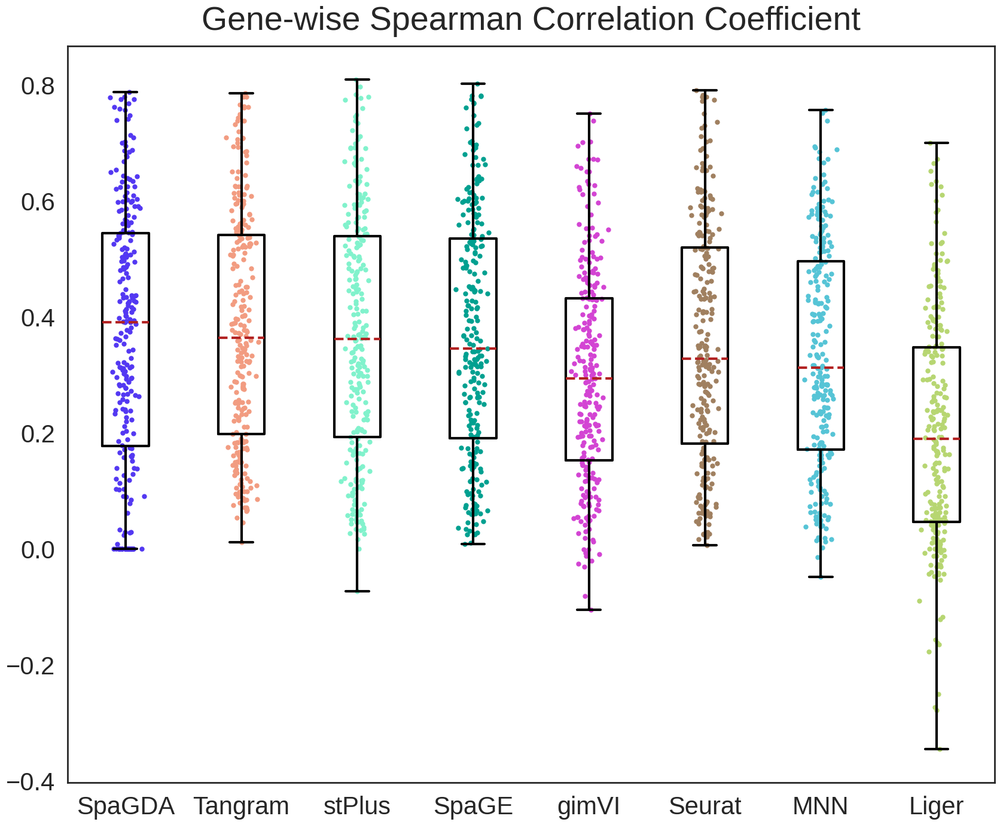

In [4]:
# SCC for MOp dataset, and Fig2A with the SCC of Rspo1 gene for each method.
'''
===> gimVI median SCC and RMSE: 0.2932, 1.6985
===> stPlus median SCC and RMSE: 0.3611, 2.1258
===> Tangram median SCC and RMSE: 0.3639, 28961.6766
===> SpaGE median SCC and RMSE: 0.3445, 2.1481
===> SpaGDA median SCC and RMSE: 0.3905, 0.4194
===> Seurat median SCC and RMSE: 0.3279, 2.1966
===> MNN median SCC and RMSE: 0.3117, 2.2131
===> Liger median SCC and RMSE: 0.1896, 0.4430


===> Note: Calculate the scc without NA genes, this is the calculate method for wencan!
===> Note: without NA gimVI median SCC and RMSE: 0.2932, 1.6985
===> Note: without NA stPlus median SCC and RMSE: 0.3611, 2.1258
===> Note: without NA Tangram median SCC and RMSE: 0.3639, 28961.6766
===> Note: without NA SpaGE median SCC and RMSE: 0.3445, 2.1481
===> Note: without NA SpaGDA median SCC and RMSE: 0.4193, 0.4194
===> Note: without NA Seurat median SCC and RMSE: 0.3279, 2.1966
===> Note: without NA MNN median SCC and RMSE: 0.3117, 2.2131
===> Note: without NA Liger median SCC and RMSE: 0.1914, 0.4430

===> Fig2A and SCC for each methods
===> Rspo1 SCC on mouse1_slice153: {'SpaGDA': 0.46066074923527023, 'Tangram': 0.39505309212556067, 
                                    'stPlus': 0.3823623950704907, 'SpaGE': 0.3906922901644611, 
                                    'gimVI': 0.36037966313359504, 'Seurat': 0.37698691542597257, 
                                    'MNN': 0.3757467092493053, 'Liger': 0.24963821902438854}
===> Otof SCC on mouse1_slice153: {'SpaGDA': 0.606336722845246, 'Tangram': 0.4840009838397928, 
                                   'stPlus': 0.5010897038979311, 'SpaGE': 0.4963470573304194, 
                                   'gimVI': 0.4709915923912362, 'Seurat': 0.5002683734193542, 
                                   'MNN': 0.488833306889804, 'Liger': 0.41652263213360663}
===> Syt6 SCC on mouse1_slice153: {'SpaGDA': 0.6067504462946961, 'Tangram': 0.5409334891272237, 
                                   'stPlus': 0.5359694820802882, 'SpaGE': 0.5211881649065551, 
                                   'gimVI': 0.44730649704678244, 'Seurat': 0.5128058275174349, 
                                   'MNN': 0.49393613976177475, 'Liger': 0.0994552483698327}

'''



dataset = 'Mop'

sub_save_dir = os.path.join(save_dir, dataset)
if not os.path.exists(sub_save_dir): os.mkdir(sub_save_dir)
sub_data_dir = os.path.join(data_dir, dataset)

SCC_list, SCC_df, visual_df, RMSE_list = load_data(dataset, sub_data_dir, sub_save_dir, csvs[0], 
                                                   h5ad_files[0])

# plots all scc
plt.style.use('seaborn-white')
fig, ax = plt.subplots(figsize=(20, 16))
ax.spines[['top','bottom','left','right']].set_linewidth(2)
boxprops = dict(linewidth=3)
medianprops = dict(linestyle='--', linewidth=3, color='firebrick')
whiskerprops = dict(linewidth=3)
capprops = dict(linewidth=3)

ax.boxplot(SCC_list, labels=methods, widths = 0.4, boxprops=boxprops, 
           medianprops=medianprops, whiskerprops=whiskerprops, capprops=capprops, showfliers=False)
for i,y in enumerate(SCC_list):
    x = np.random.normal(i+1, 0.05, len(y))
    ax.scatter(x, y, c=method_color_pal[methods[i]], marker='o', s=25, label='%s: %.4f'%(methods[i],y.median()))
ax.tick_params(axis='x', labelsize=30, pad=15)
ax.tick_params(axis='y', labelsize=30, pad=15)
ax.set_title('Gene-wise Spearman Correlation Coefficient', fontsize=40, pad=20)
plt.yticks(rotation=0)
plt.xticks(rotation=0)
fig.savefig(os.path.join(sub_save_dir,'Gene_Spearman_Corr_%s.pdf'%dataset),  bbox_inches='tight')
plt.show()
plt.close()

## Pair-wise compare correlations
custom_params = {'font.size': 20, 'lines.linewidth': 2, 'legend.fontsize': 10,  'xtick.labelsize': 15, 
                 'ytick.labelsize': 15,}
sns.set_theme(style="white", rc=custom_params)
for method in methods[1:]:
    slope, intercept, r_value, p_value, std_err = st.linregress(SCC_df['SpaGDA'],SCC_df[method])
    _,p_val = st.wilcoxon(SCC_df['SpaGDA'],SCC_df[method])

    low, high = dataset_lows[0], dataset_highs[0]
    g = sns.JointGrid(x="SpaGDA", y=method, data=SCC_df, space=0.1, marginal_ticks=True, xlim=[low, high], ylim=[low, high])
    g = g.plot_joint(sns.regplot, line_kws={'color': method_color_pal[method], 'linewidth': 2, 'label':'R\u00b2: %.2f \nslope: %.2f \np_val: %.2e'%(r_value*r_value,slope,p_val)}, 
                                          scatter_kws={'color': method_color_pal[method], 's': 30, 'linewidths': 0.1})

    ax1 = g.ax_joint
    ax1.axline((0, 0), slope=1, color='black', linewidth=1, linestyle='--')
    ax1.set_xlabel('SpaGDA', fontsize=15)
    ax1.set_ylabel(method, fontsize=15)
    ax1.legend(fontsize=15, loc=2)
    axx = g.ax_marg_x
    axy = g.ax_marg_y
    sns.histplot(SCC_df, color=method_color_pal['SpaGDA'], x='SpaGDA', ax=axx, kde=True)
    sns.histplot(SCC_df, color=method_color_pal[method], y=method, ax=axy, kde=True)
    axx.set_ylabel('Count', fontsize=15)
    axy.set_xlabel('Count', fontsize=15)
    g.savefig(os.path.join(sub_save_dir, '%s_compare_%s.pdf'%(dataset,method)), bbox_inches='tight')
    plt.close()

#statistic the top 1 rank number of all methods
data_arr = np.argmax(SCC_df.to_numpy(),axis=1)
unique, count = np.unique(data_arr, return_counts=True)
for k,v in enumerate(unique):
    top1_all_arr[0][v] = count[k]

#statistic the rank number of SpaGDA
rank_scc_df = SCC_df.rank(axis='columns',ascending=False)
unique, count = np.unique(rank_scc_df['SpaGDA'], return_counts=True)
for k,v in enumerate(unique):
    SpaGDA_rank_arr[0][int(v)-1] = count[k] 


#merge all scc of datasets in a dataframe.
for j, method in enumerate(methods):
    method_df = pd.DataFrame(columns=['gene','Spearman Correlation','Methods','Datasets'])
    method_df['gene'] = SCC_df.index.to_list()
    method_df['Spearman Correlation'] = SCC_df[method].to_list()
    method_df['Methods'] = [method]*SCC_df.shape[0]
    method_df['Datasets'] = [dataset_names[0]]*SCC_df.shape[0]
     
    #scc_all_df = scc_all_df.append(method_df)
    scc_all_df = pd.concat([scc_all_df,method_df], axis=0)
    median_scc_all_arr[0][j] = SCC_df[method].median()

rmse_all_arr[0] = np.array(RMSE_list, dtype='float16')

Processing Moffit ...

===> gimVI median SCC and RMSE: 0.2494, 0.8460
===> stPlus median SCC and RMSE: 0.2794, 1.5418
===> Tangram median SCC and RMSE: 0.2023, 5.0826
===> SpaGE median SCC and RMSE: 0.2631, 1.4365
===> SpaGDA median SCC and RMSE: 0.3040, 0.4981
===> Seurat median SCC and RMSE: 0.2478, 1.4323
===> MNN median SCC and RMSE: 0.2051, 1.4753
===> Liger median SCC and RMSE: 0.0327, 0.7701
Index(['SpaGDA', 'Tangram', 'stPlus', 'SpaGE', 'gimVI', 'Seurat', 'MNN',
       'Liger'],
      dtype='object') (153, 8)
['Aldh1l1' 'Aqp4' 'Ar' 'Arhgap36' 'Brs3' 'Cckbr' 'Cenpe' 'Chat' 'Coch'
 'Cplx3' 'Crhbp' 'Crhr1' 'Crhr2' 'Cxcl14' 'Cyp19a1' 'Cyp26a1' 'Cyr61'
 'Egr2' 'Esr1' 'Fbxw13' 'Fst' 'Galr2' 'Glra3' 'Greb1' 'Grpr' 'Igf2r'
 'Kiss1r' 'Klf4' 'Lepr' 'Mbp' 'Mc4r' 'Mki67' 'Mlc1' 'Ndnf' 'Npas1' 'Ntsr1'
 'Nup62cl' 'Onecut2' 'Oxt' 'Oxtr' 'Pdgfra' 'Plin3' 'Prlr' 'Rgs5' 'Rxfp1'
 'Scgn' 'Serpinb1b' 'Slc17a6' 'Slc17a7' 'Slc17a8' 'Slco1a4' 'Synpr' 'Syt2'
 'Tacr3' 'Tiparp' 'Tmem108' 'Trhr' 'Ttn' 'Tt

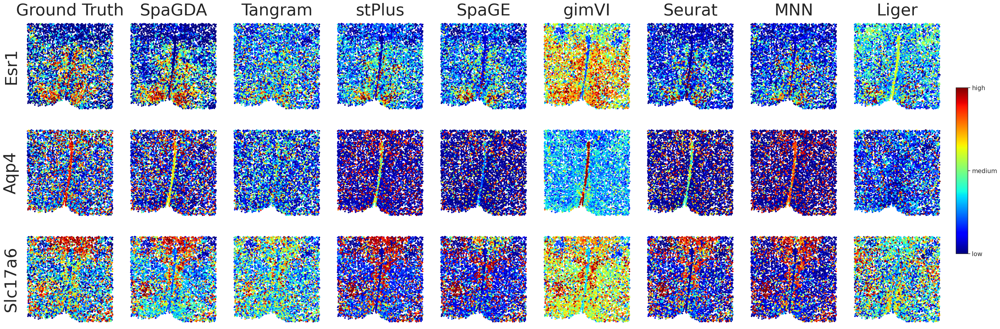

===> Esr1 SCC on slice -0.14: {'SpaGDA': 0.6402801454066228, 'Tangram': 0.4043604493857071, 'stPlus': 0.6360381016975108, 'SpaGE': 0.6013590136016509, 'gimVI': 0.4947411977005865, 'Seurat': 0.618312925743861, 'MNN': 0.4874868995771834, 'Liger': 0.09038118988280396}


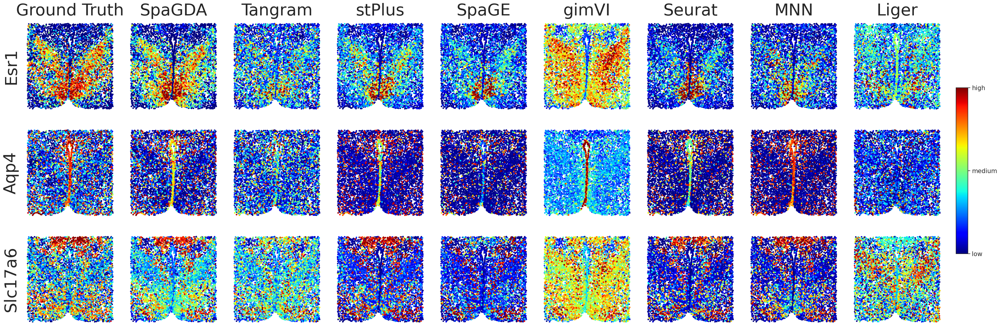

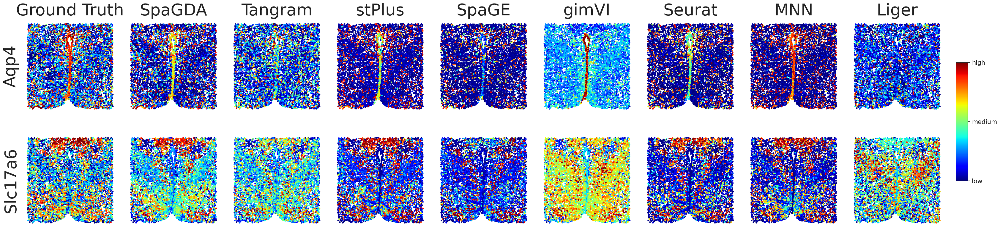

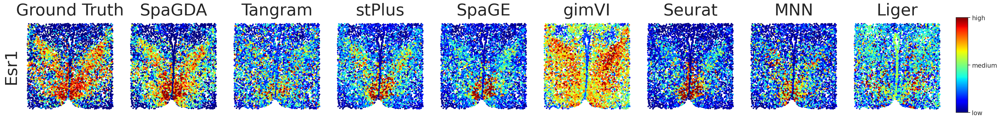

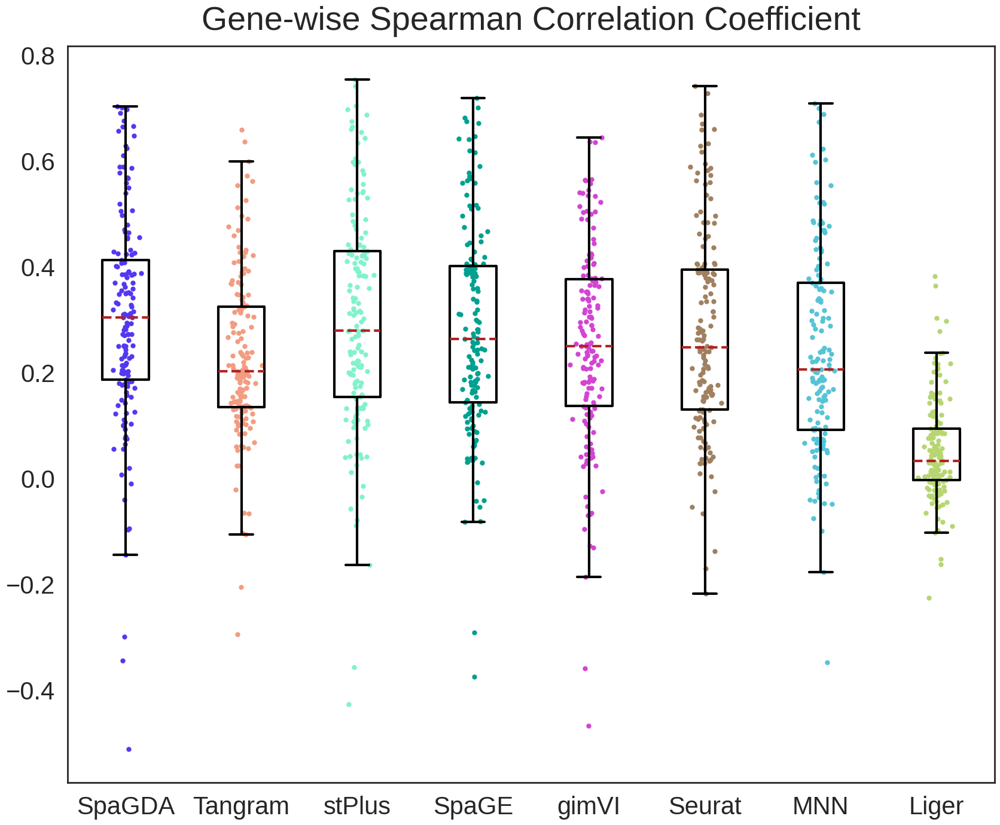

In [5]:
# SCC for HPR dataset.
'''
===> gimVI median SCC and RMSE: 0.2494, 0.8460
===> stPlus median SCC and RMSE: 0.2794, 1.5418
===> Tangram median SCC and RMSE: 0.2023, 5.0826
===> SpaGE median SCC and RMSE: 0.2631, 1.4365
===> SpaGDA median SCC and RMSE: 0.3040, 0.4981
===> Seurat median SCC and RMSE: 0.2478, 1.4323
===> MNN median SCC and RMSE: 0.2051, 1.4753
===> Liger median SCC and RMSE: 0.0327, 0.7701

===> Esr1 SCC of all slices on sample 1: {'SpaGDA': 0.5863184868458556, 'Tangram': 0.3469077439717177, 
                                          'stPlus': 0.5561564783720298, 'SpaGE': 0.5350253916487984, 
                                          'gimVI': 0.5216404576487009, 'Seurat': 0.5352788502334422, 
                                          'MNN': 0.4499646916477116, 'Liger': 0.056199310178321187}
===> save ground truth and imputed results of selected genes for 3D views at 
           /data/bioinf/jyuan/rongboshen/SpaGDA/draw_fig2/Moffit/all_visual_genes_df.csv


===> Esr1 SCC on slice -0.14: {'SpaGDA': 0.6402801454066228, 'Tangram': 0.4043604493857071, 
                               'stPlus': 0.6360381016975108, 'SpaGE': 0.6013590136016509, 
                               'gimVI': 0.4947411977005865, 'Seurat': 0.618312925743861, 
                               'MNN': 0.4874868995771834, 'Liger': 0.09038118988280396}

'''

dataset = 'Moffit'

sub_save_dir = os.path.join(save_dir, dataset)
if not os.path.exists(sub_save_dir): os.mkdir(sub_save_dir)
sub_data_dir = os.path.join(data_dir, dataset)

SCC_list, SCC_df, visual_df, RMSE_list = load_data(dataset, sub_data_dir, sub_save_dir, csvs[1], 
                                                   h5ad_files[1])

# plots all scc
plt.style.use('seaborn-white')
fig, ax = plt.subplots(figsize=(20, 16))
ax.spines[['top','bottom','left','right']].set_linewidth(2)
boxprops = dict(linewidth=3)
medianprops = dict(linestyle='--', linewidth=3, color='firebrick')
whiskerprops = dict(linewidth=3)
capprops = dict(linewidth=3)

ax.boxplot(SCC_list, labels=methods, widths = 0.4, boxprops=boxprops, 
           medianprops=medianprops, whiskerprops=whiskerprops, capprops=capprops, showfliers=False)
for i,y in enumerate(SCC_list):
    x = np.random.normal(i+1, 0.05, len(y))
    ax.scatter(x, y, c=method_color_pal[methods[i]], marker='o', s=25, label='%s: %.4f'%(methods[i],y.median()))
ax.tick_params(axis='x', labelsize=30, pad=15)
ax.tick_params(axis='y', labelsize=30, pad=15)
ax.set_title('Gene-wise Spearman Correlation Coefficient', fontsize=40, pad=20)
plt.yticks(rotation=0)
plt.xticks(rotation=0)
fig.savefig(os.path.join(sub_save_dir,'Gene_Spearman_Corr_%s.pdf'%dataset),  bbox_inches='tight')
plt.show()
plt.close()

## Pair-wise compare correlations
custom_params = {'font.size': 20, 'lines.linewidth': 2, 'legend.fontsize': 10,  'xtick.labelsize': 15, 
                 'ytick.labelsize': 15,}
sns.set_theme(style="white", rc=custom_params)
for method in methods[1:]:
    slope, intercept, r_value, p_value, std_err = st.linregress(SCC_df['SpaGDA'],SCC_df[method])
    _,p_val = st.wilcoxon(SCC_df['SpaGDA'],SCC_df[method])

    low, high = dataset_lows[1], dataset_highs[1]
    g = sns.JointGrid(x="SpaGDA", y=method, data=SCC_df, space=0.1, marginal_ticks=True, xlim=[low, high], ylim=[low, high])
    g = g.plot_joint(sns.regplot, line_kws={'color': method_color_pal[method], 'linewidth': 2, 'label':'R\u00b2: %.2f \nslope: %.2f \np_val: %.2e'%(r_value*r_value,slope,p_val)}, 
                                          scatter_kws={'color': method_color_pal[method], 's': 30, 'linewidths': 0.1})

    ax1 = g.ax_joint
    ax1.axline((0, 0), slope=1, color='black', linewidth=1, linestyle='--')
    ax1.set_xlabel('SpaGDA', fontsize=15)
    ax1.set_ylabel(method, fontsize=15)
    ax1.legend(fontsize=15, loc=2)
    axx = g.ax_marg_x
    axy = g.ax_marg_y
    sns.histplot(SCC_df, color=method_color_pal['SpaGDA'], x='SpaGDA', ax=axx, kde=True)
    sns.histplot(SCC_df, color=method_color_pal[method], y=method, ax=axy, kde=True)
    axx.set_ylabel('Count', fontsize=15)
    axy.set_xlabel('Count', fontsize=15)
    g.savefig(os.path.join(sub_save_dir, '%s_compare_%s.pdf'%(dataset,method)), bbox_inches='tight')
    plt.close()

#statistic the top 1 rank number of all methods
data_arr = np.argmax(SCC_df.to_numpy(),axis=1)
unique, count = np.unique(data_arr, return_counts=True)
for k,v in enumerate(unique):
    top1_all_arr[1][v] = count[k]

#statistic the rank number of SpaGDA
rank_scc_df = SCC_df.rank(axis='columns',ascending=False)
unique, count = np.unique(rank_scc_df['SpaGDA'], return_counts=True)
for k,v in enumerate(unique):
    SpaGDA_rank_arr[1][int(v)-1] = count[k] 


#merge all scc of datasets in a dataframe.
for j, method in enumerate(methods):
    method_df = pd.DataFrame(columns=['gene','Spearman Correlation','Methods','Datasets'])
    method_df['gene'] = SCC_df.index.to_list()
    method_df['Spearman Correlation'] = SCC_df[method].to_list()
    method_df['Methods'] = [method]*SCC_df.shape[0]
    method_df['Datasets'] = [dataset_names[1]]*SCC_df.shape[0]
     
    #scc_all_df = scc_all_df.append(method_df)
    scc_all_df = pd.concat([scc_all_df,method_df], axis=0)
    median_scc_all_arr[1][j] = SCC_df[method].median()

rmse_all_arr[1] = np.array(RMSE_list, dtype='float16')

Processing Sperm ...

===> gimVI median SCC and RMSE: 0.3111, 0.2842
===> stPlus median SCC and RMSE: 0.2935, 14.3224
===> Tangram median SCC and RMSE: 0.2594, 287.4857
===> SpaGE median SCC and RMSE: 0.3205, 19.6093
===> SpaGDA median SCC and RMSE: 0.3237, 0.3045
===> Seurat median SCC and RMSE: 0.2836, 15.8386
===> MNN median SCC and RMSE: 0.2137, 22.3349
===> Liger median SCC and RMSE: 0.2054, 0.3780
Index(['SpaGDA', 'Tangram', 'stPlus', 'SpaGE', 'gimVI', 'Seurat', 'MNN',
       'Liger'],
      dtype='object') (324, 8)
['1700001C19Rik' '1700001K19Rik' '1700003F12Rik' '1700016H13Rik'
 '1700019N19Rik' '1700026L06Rik' '1700031M16Rik' 'AI507597' 'Akap12'
 'Ankef1' 'Cabs1' 'Chl1' 'Crisp2' 'Dnajb8' 'Dnajc5b' 'Fhl4' 'Gm9999'
 'Hrasls5' 'Nrd1' 'Nupr1l' 'Psma6' 'Psmf1' 'Sh3d21' 'Smim24' 'Spata7'
 'Spert' 'Srpk2' 'St6galnac2' 'Ybx3']


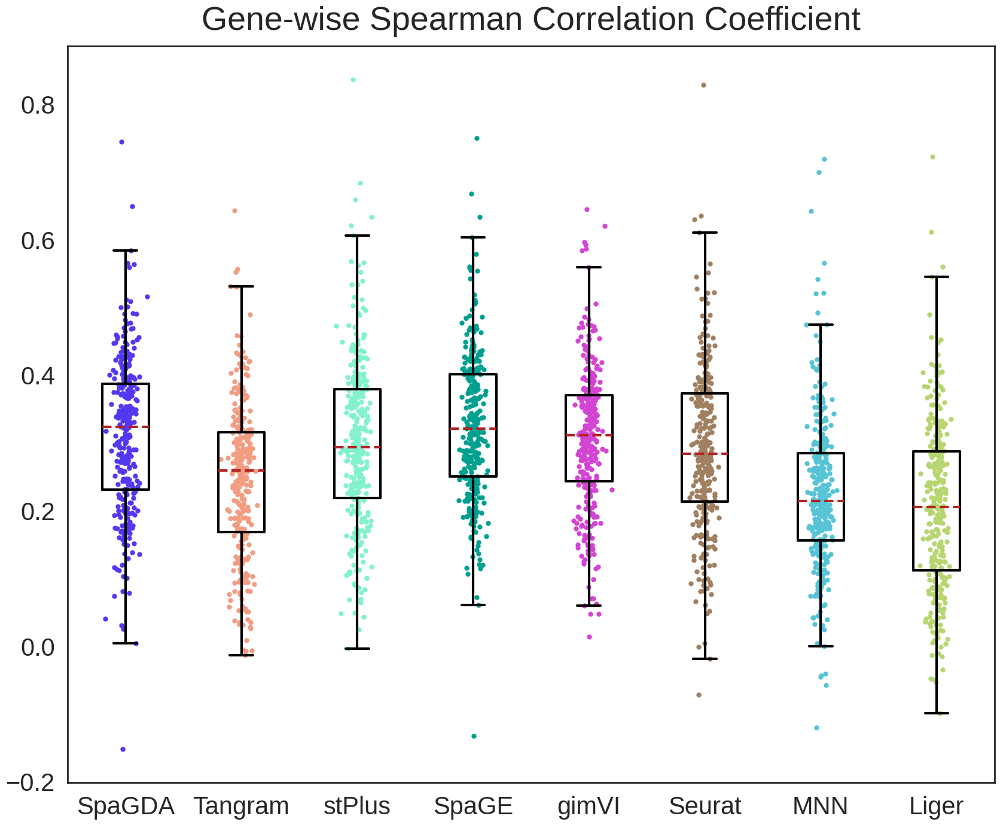

In [6]:
# SCC for Testis dataset.

'''
===> gimVI median SCC and RMSE: 0.3111, 0.2842
===> stPlus median SCC and RMSE: 0.2935, 14.3224
===> Tangram median SCC and RMSE: 0.2594, 287.4857
===> SpaGE median SCC and RMSE: 0.3205, 19.6093
===> SpaGDA median SCC and RMSE: 0.3237, 0.3045
===> Seurat median SCC and RMSE: 0.2836, 15.8386
===> MNN median SCC and RMSE: 0.2137, 22.3349
===> Liger median SCC and RMSE: 0.2054, 0.3780


===> Cabs1 SCC: {'SpaGDA': 0.4683636419443102, 'Tangram': 0.3774268724538724, 
                 'stPlus': 0.4426364399160574, 'SpaGE': 0.46060473676220404, 
                 'gimVI': 0.36097152062547977, 'Seurat': 0.43671422617140965, 
                 'MNN': 0.37062871343226134, 'Liger': 0.38241110792415295}


'''



dataset = 'Sperm'

sub_save_dir = os.path.join(save_dir, dataset)
if not os.path.exists(sub_save_dir): os.mkdir(sub_save_dir)
sub_data_dir = os.path.join(data_dir, dataset)

SCC_list, SCC_df, visual_df, RMSE_list = load_data(dataset, sub_data_dir, sub_save_dir, csvs[2], 
                                                   h5ad_files[2])

# plots all scc
plt.style.use('seaborn-white')
fig, ax = plt.subplots(figsize=(20, 16))
ax.spines[['top','bottom','left','right']].set_linewidth(2)
boxprops = dict(linewidth=3)
medianprops = dict(linestyle='--', linewidth=3, color='firebrick')
whiskerprops = dict(linewidth=3)
capprops = dict(linewidth=3)

ax.boxplot(SCC_list, labels=methods, widths = 0.4, boxprops=boxprops, 
           medianprops=medianprops, whiskerprops=whiskerprops, capprops=capprops, showfliers=False)
for i,y in enumerate(SCC_list):
    x = np.random.normal(i+1, 0.05, len(y))
    ax.scatter(x, y, c=method_color_pal[methods[i]], marker='o', s=25, label='%s: %.4f'%(methods[i],y.median()))
ax.tick_params(axis='x', labelsize=30, pad=15)
ax.tick_params(axis='y', labelsize=30, pad=15)
ax.set_title('Gene-wise Spearman Correlation Coefficient', fontsize=40, pad=20)
plt.yticks(rotation=0)
plt.xticks(rotation=0)
fig.savefig(os.path.join(sub_save_dir,'Gene_Spearman_Corr_%s.pdf'%dataset),  bbox_inches='tight')
plt.show()
plt.close()

## Pair-wise compare correlations
custom_params = {'font.size': 20, 'lines.linewidth': 2, 'legend.fontsize': 10,  'xtick.labelsize': 15, 
                 'ytick.labelsize': 15,}
sns.set_theme(style="white", rc=custom_params)
for method in methods[1:]:
    slope, intercept, r_value, p_value, std_err = st.linregress(SCC_df['SpaGDA'],SCC_df[method])
    _,p_val = st.wilcoxon(SCC_df['SpaGDA'],SCC_df[method])

    low, high = dataset_lows[2], dataset_highs[2]
    g = sns.JointGrid(x="SpaGDA", y=method, data=SCC_df, space=0.1, marginal_ticks=True, xlim=[low, high], ylim=[low, high])
    g = g.plot_joint(sns.regplot, line_kws={'color': method_color_pal[method], 'linewidth': 2, 'label':'R\u00b2: %.2f \nslope: %.2f \np_val: %.2e'%(r_value*r_value,slope,p_val)}, 
                                          scatter_kws={'color': method_color_pal[method], 's': 30, 'linewidths': 0.1})

    ax1 = g.ax_joint
    ax1.axline((0, 0), slope=1, color='black', linewidth=1, linestyle='--')
    ax1.set_xlabel('SpaGDA', fontsize=15)
    ax1.set_ylabel(method, fontsize=15)
    ax1.legend(fontsize=15, loc=2)
    axx = g.ax_marg_x
    axy = g.ax_marg_y
    sns.histplot(SCC_df, color=method_color_pal['SpaGDA'], x='SpaGDA', ax=axx, kde=True)
    sns.histplot(SCC_df, color=method_color_pal[method], y=method, ax=axy, kde=True)
    axx.set_ylabel('Count', fontsize=15)
    axy.set_xlabel('Count', fontsize=15)
    g.savefig(os.path.join(sub_save_dir, '%s_compare_%s.pdf'%(dataset,method)), bbox_inches='tight')
    plt.close()

#statistic the top 1 rank number of all methods
data_arr = np.argmax(SCC_df.to_numpy(),axis=1)
unique, count = np.unique(data_arr, return_counts=True)
for k,v in enumerate(unique):
    top1_all_arr[2][v] = count[k]

#statistic the rank number of SpaGDA
rank_scc_df = SCC_df.rank(axis='columns',ascending=False)
unique, count = np.unique(rank_scc_df['SpaGDA'], return_counts=True)
for k,v in enumerate(unique):
    SpaGDA_rank_arr[2][int(v)-1] = count[k] 


#merge all scc of datasets in a dataframe.
for j, method in enumerate(methods):
    method_df = pd.DataFrame(columns=['gene','Spearman Correlation','Methods','Datasets'])
    method_df['gene'] = SCC_df.index.to_list()
    method_df['Spearman Correlation'] = SCC_df[method].to_list()
    method_df['Methods'] = [method]*SCC_df.shape[0]
    method_df['Datasets'] = [dataset_names[2]]*SCC_df.shape[0]
     
    #scc_all_df = scc_all_df.append(method_df)
    scc_all_df = pd.concat([scc_all_df,method_df], axis=0)
    median_scc_all_arr[2][j] = SCC_df[method].median()

rmse_all_arr[2] = np.array(RMSE_list, dtype='float16')

Processing Starmap ...

===> gimVI median SCC and RMSE: 0.1361, 0.1648
===> stPlus median SCC and RMSE: 0.1221, 6.5446
===> Tangram median SCC and RMSE: 0.1270, 676.6105
===> SpaGE median SCC and RMSE: 0.1195, 7.0245
===> SpaGDA median SCC and RMSE: 0.1337, 0.3799
===> Seurat median SCC and RMSE: 0.0916, 6.7558
===> MNN median SCC and RMSE: 0.0745, 6.9514
===> Liger median SCC and RMSE: 0.0765, 12.8080
Index(['SpaGDA', 'Tangram', 'stPlus', 'SpaGE', 'gimVI', 'Seurat', 'MNN',
       'Liger'],
      dtype='object') (994, 8)
['1700019D03Rik' 'Acat2' 'Acot13' 'Adamts18' 'Adamts2' 'Adamts3' 'Adk'
 'Aldh3a2' 'Anapc13' 'Arl4a' 'Arl4d' 'Arx' 'B3galt2' 'Bace2' 'Bglap3'
 'Blnk' 'Calca' 'Camk2d' 'Cartpt' 'Cav1' 'Ccdc109b' 'Cdca7' 'Cdk4' 'Cdk6'
 'Cenpw' 'Chat' 'Chrna6' 'Cntn4' 'Col14a1' 'Col25a1' 'Cpne4' 'Cpne5'
 'Cxcl14' 'Cyb5r1' 'Cygb' 'Dcdc2c' 'Depdc7' 'Deptor' 'Dlx2' 'Eef1e1'
 'Egln3' 'Elfn1' 'Fam81a' 'Fbxw11' 'Fosl1' 'Foxp2' 'Frem1' 'Frmd7'
 'Frmpd3' 'Gda' 'Glul' 'Gm15881' 'Gm5643' 'Gpr151' 'G

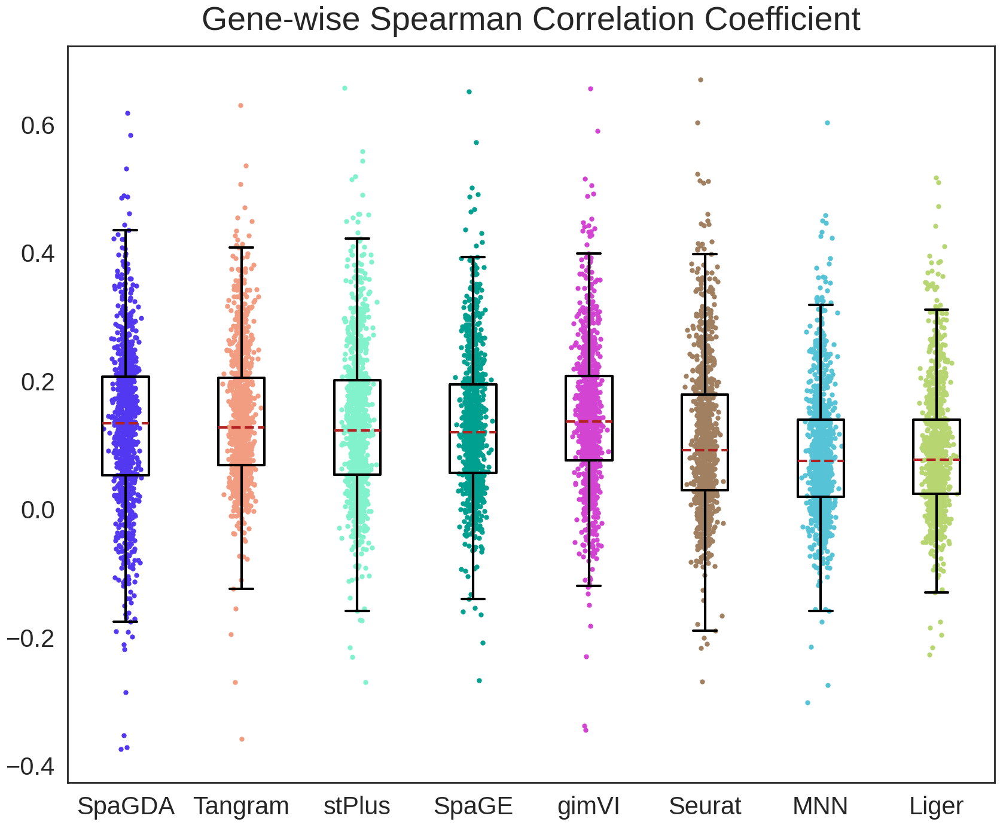

In [7]:
# SCC for VISp dataset.
'''
===> gimVI median SCC and RMSE: 0.1361, 0.1648
===> stPlus median SCC and RMSE: 0.1221, 6.5446
===> Tangram median SCC and RMSE: 0.1270, 676.6105
===> SpaGE median SCC and RMSE: 0.1195, 7.0245
===> SpaGDA median SCC and RMSE: 0.1337, 0.3799
===> Seurat median SCC and RMSE: 0.0916, 6.7558
===> MNN median SCC and RMSE: 0.0745, 6.9514
===> Liger median SCC and RMSE: 0.0765, 12.8080

===> Plp1 SCC: {'SpaGDA': 0.5309501825760253, 'Tangram': 0.22262123167115627, 
                'stPlus': 0.4600585354370714, 'SpaGE': 0.41042158891335834, 
                'gimVI': -0.10685107958646532, 'Seurat': 0.4439973177487484, 
                'MNN': 0.4454362145573783, 'Liger': 0.35120040775166445}
'''



dataset = 'Starmap'

sub_save_dir = os.path.join(save_dir, dataset)
if not os.path.exists(sub_save_dir): os.mkdir(sub_save_dir)
sub_data_dir = os.path.join(data_dir, dataset)

SCC_list, SCC_df, visual_df, RMSE_list = load_data(dataset, sub_data_dir, sub_save_dir, csvs[3], 
                                                   h5ad_files[3])

# plots all scc
plt.style.use('seaborn-white')
fig, ax = plt.subplots(figsize=(20, 16))
ax.spines[['top','bottom','left','right']].set_linewidth(2)
boxprops = dict(linewidth=3)
medianprops = dict(linestyle='--', linewidth=3, color='firebrick')
whiskerprops = dict(linewidth=3)
capprops = dict(linewidth=3)

ax.boxplot(SCC_list, labels=methods, widths = 0.4, boxprops=boxprops, 
           medianprops=medianprops, whiskerprops=whiskerprops, capprops=capprops, showfliers=False)
for i,y in enumerate(SCC_list):
    x = np.random.normal(i+1, 0.05, len(y))
    ax.scatter(x, y, c=method_color_pal[methods[i]], marker='o', s=25, label='%s: %.4f'%(methods[i],y.median()))
ax.tick_params(axis='x', labelsize=30, pad=15)
ax.tick_params(axis='y', labelsize=30, pad=15)
ax.set_title('Gene-wise Spearman Correlation Coefficient', fontsize=40, pad=20)
plt.yticks(rotation=0)
plt.xticks(rotation=0)
fig.savefig(os.path.join(sub_save_dir,'Gene_Spearman_Corr_%s.pdf'%dataset),  bbox_inches='tight')
plt.show()
plt.close()

## Pair-wise compare correlations
custom_params = {'font.size': 20, 'lines.linewidth': 2, 'legend.fontsize': 10,  'xtick.labelsize': 15, 
                 'ytick.labelsize': 15,}
sns.set_theme(style="white", rc=custom_params)
for method in methods[1:]:
    slope, intercept, r_value, p_value, std_err = st.linregress(SCC_df['SpaGDA'],SCC_df[method])
    _,p_val = st.wilcoxon(SCC_df['SpaGDA'],SCC_df[method])

    low, high = dataset_lows[3], dataset_highs[3]
    g = sns.JointGrid(x="SpaGDA", y=method, data=SCC_df, space=0.1, marginal_ticks=True, xlim=[low, high], ylim=[low, high])
    g = g.plot_joint(sns.regplot, line_kws={'color': method_color_pal[method], 'linewidth': 2, 'label':'R\u00b2: %.2f \nslope: %.2f \np_val: %.2e'%(r_value*r_value,slope,p_val)}, 
                                          scatter_kws={'color': method_color_pal[method], 's': 30, 'linewidths': 0.1})

    ax1 = g.ax_joint
    ax1.axline((0, 0), slope=1, color='black', linewidth=1, linestyle='--')
    ax1.set_xlabel('SpaGDA', fontsize=15)
    ax1.set_ylabel(method, fontsize=15)
    ax1.legend(fontsize=15, loc=2)
    axx = g.ax_marg_x
    axy = g.ax_marg_y
    sns.histplot(SCC_df, color=method_color_pal['SpaGDA'], x='SpaGDA', ax=axx, kde=True)
    sns.histplot(SCC_df, color=method_color_pal[method], y=method, ax=axy, kde=True)
    axx.set_ylabel('Count', fontsize=15)
    axy.set_xlabel('Count', fontsize=15)
    g.savefig(os.path.join(sub_save_dir, '%s_compare_%s.pdf'%(dataset,method)), bbox_inches='tight')
    plt.close()

#statistic the top 1 rank number of all methods
data_arr = np.argmax(SCC_df.to_numpy(),axis=1)
unique, count = np.unique(data_arr, return_counts=True)
for k,v in enumerate(unique):
    top1_all_arr[3][v] = count[k]

#statistic the rank number of SpaGDA
rank_scc_df = SCC_df.rank(axis='columns',ascending=False)
unique, count = np.unique(rank_scc_df['SpaGDA'], return_counts=True)
for k,v in enumerate(unique):
    SpaGDA_rank_arr[3][int(v)-1] = count[k] 


#merge all scc of datasets in a dataframe.
for j, method in enumerate(methods):
    method_df = pd.DataFrame(columns=['gene','Spearman Correlation','Methods','Datasets'])
    method_df['gene'] = SCC_df.index.to_list()
    method_df['Spearman Correlation'] = SCC_df[method].to_list()
    method_df['Methods'] = [method]*SCC_df.shape[0]
    method_df['Datasets'] = [dataset_names[3]]*SCC_df.shape[0]
     
    #scc_all_df = scc_all_df.append(method_df)
    scc_all_df = pd.concat([scc_all_df,method_df], axis=0)
    median_scc_all_arr[3][j] = SCC_df[method].median()

rmse_all_arr[3] = np.array(RMSE_list, dtype='float16')

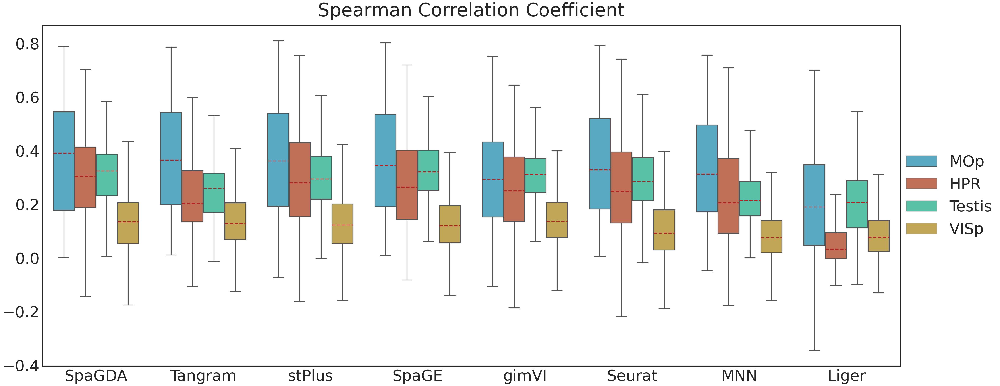

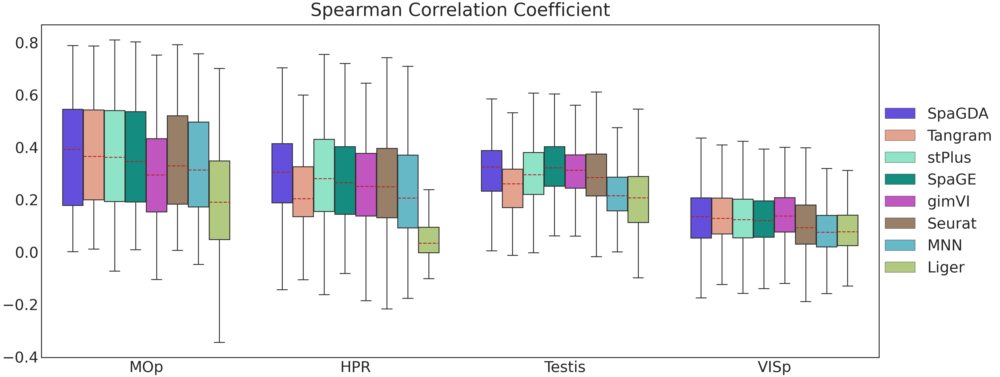

In [8]:
#Fig2E, this version has different with wencan's.

# Plot merged image. 

boxprops = dict(linewidth=3)
medianprops = dict(linestyle='--', linewidth=3, color='firebrick')
whiskerprops = dict(linewidth=3)
capprops = dict(linewidth=3)


fig, ax = plt.subplots(figsize=(50,20))
ax.spines[['top','bottom','left','right']].set_linewidth(3)
ax = sns.boxplot(data=scc_all_df, ax=ax, x='Methods', y='Spearman Correlation', palette=dataset_color_pal, hue='Datasets', hue_order=dataset_names, showfliers=False,
                 boxprops=boxprops, medianprops=medianprops, whiskerprops=whiskerprops, capprops=capprops)
ax.tick_params(axis='x', labelsize=50)
ax.tick_params(axis='y', labelsize=50)
ax.set_title('Spearman Correlation Coefficient', fontsize=60, pad=30)
ax.set(ylabel=None, xlabel=None)
#ax.legend(loc=1, ncols=4, fontsize=50)
ax.legend(bbox_to_anchor=(1,0.5),loc=6, fontsize=50, borderaxespad=0)
fig.savefig(os.path.join(save_dir, 'scc_all_box.pdf'), bbox_inches='tight')
plt.show()
plt.close()

# Plot merged image based on dataset. 
fig, ax = plt.subplots(figsize=(50,20))
ax.spines[['top','bottom','left','right']].set_linewidth(3)
ax = sns.boxplot(data=scc_all_df, ax=ax, x='Datasets', y='Spearman Correlation', palette=method_color_pal, hue='Methods', hue_order=methods, showfliers=False,
                 boxprops=boxprops, medianprops=medianprops, whiskerprops=whiskerprops, capprops=capprops)
ax.tick_params(axis='x', labelsize=50)
ax.tick_params(axis='y', labelsize=50)
ax.set_title('Spearman Correlation Coefficient', fontsize=60, pad=30)
ax.set(ylabel=None, xlabel=None)
#ax.legend(loc=1, ncols=4, fontsize=50)
ax.legend(bbox_to_anchor=(1,0.5),loc=6, fontsize=50, borderaxespad=0)
fig.savefig(os.path.join(save_dir, 'dataset_scc_all_box.pdf'), bbox_inches='tight')
plt.show()
plt.close()

===> DAGCN median SCC and RMSE: 0.3040, 0.4981
===> DAGCN S5 median SCC and RMSE: 0.2953, 0.5201
===> DAGCN S10 median SCC and RMSE: 0.2937, 0.5073
===> DAGCN S15 median SCC and RMSE: 0.2896, 0.5178
===> DAGCN S20 median SCC and RMSE: 0.2905, 0.5008
===> DAGCN S25 median SCC and RMSE: 0.2899, 0.4993
===> DAGCN S35 median SCC and RMSE: 0.2801, 0.5134
===> DAGCN S40 median SCC and RMSE: 0.3008, 0.4999
===> DAGCN S45 median SCC and RMSE: 0.2949, 0.5002
===> DAGCN S50 median SCC and RMSE: 0.2971, 0.4998
Index(['S5', 'S10', 'S15', 'S20', 'S25', 'S30', 'S35', 'S40', 'S45', 'S50'], dtype='object') (153, 10)
===> Data of Fig2G was saved in /data/bioinf/jyuan/rongboshen/SpaGDA/draw_fig2/Moffit/sigma/SCC_df.csv


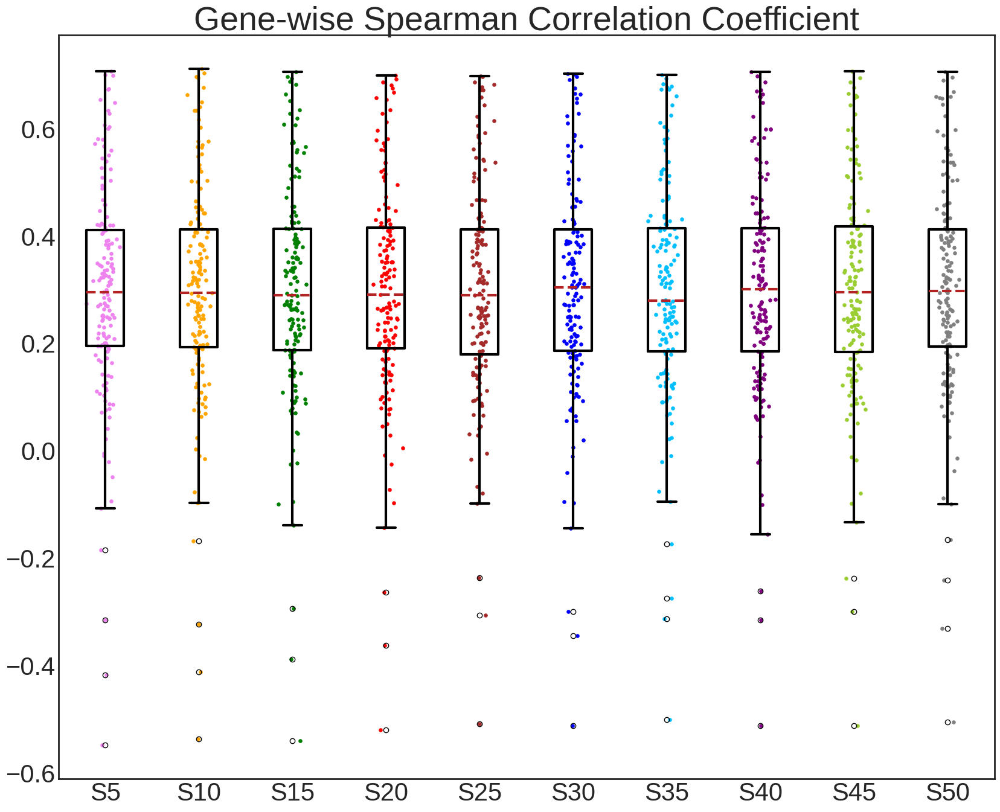

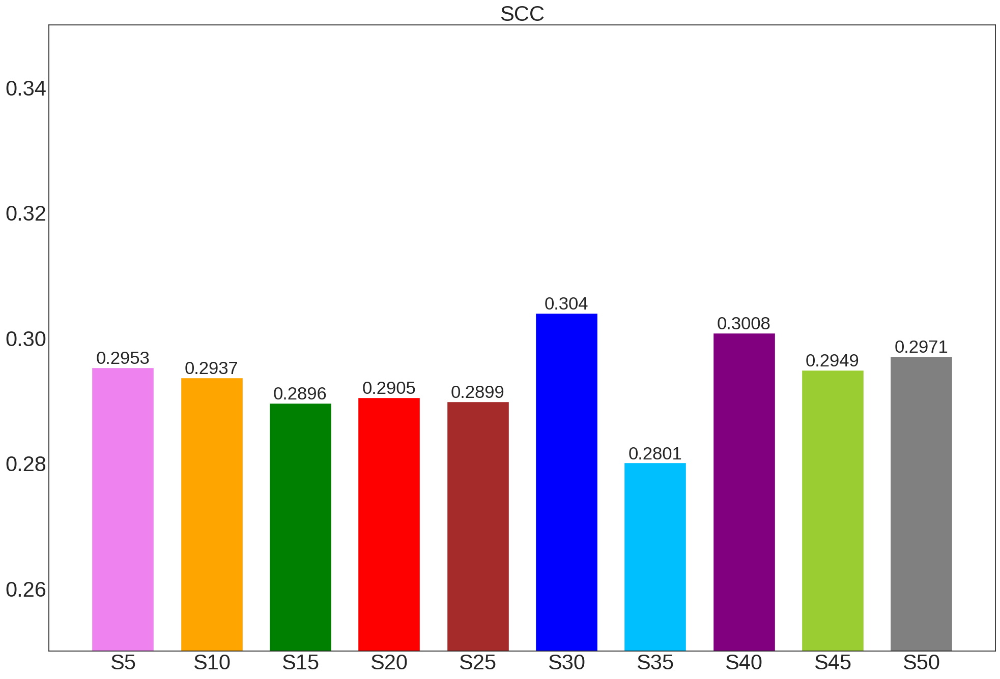

===> Fig2G


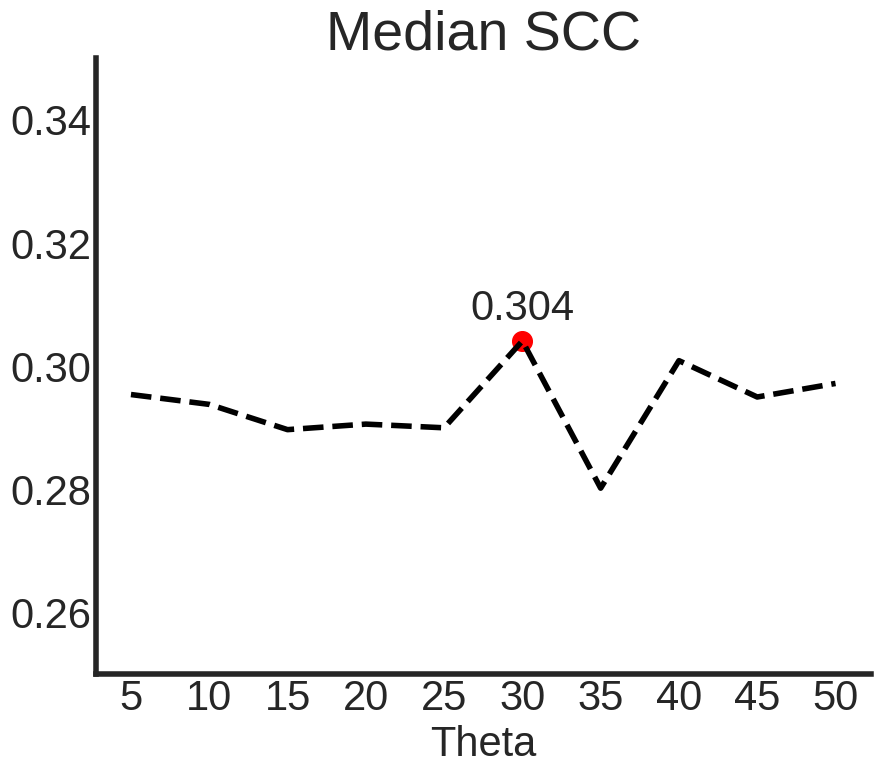

In [9]:
# Fig2G and its data.
'''
===> DAGCN median SCC and RMSE: 0.3040, 0.4981
===> DAGCN S5 median SCC and RMSE: 0.2953, 0.5201
===> DAGCN S10 median SCC and RMSE: 0.2937, 0.5073
===> DAGCN S15 median SCC and RMSE: 0.2896, 0.5178
===> DAGCN S20 median SCC and RMSE: 0.2905, 0.5008
===> DAGCN S25 median SCC and RMSE: 0.2899, 0.4993
===> DAGCN S35 median SCC and RMSE: 0.2801, 0.5134
===> DAGCN S40 median SCC and RMSE: 0.3008, 0.4999
===> DAGCN S45 median SCC and RMSE: 0.2949, 0.5002
===> DAGCN S50 median SCC and RMSE: 0.2971, 0.4998

===> Data of Fig2G was saved in /data/bioinf/jyuan/rongboshen/SpaGDA/draw_fig2/Moffit/sigma/SCC_df.csv
===> Fig2G
'''


# Set arguments and hyper-parameters.

dataset = 'Moffit'
data_dir = '/data/bioinf/jyuan/rongboshen/SpaGDA/results/imputation'
save_dir = '/data/bioinf/jyuan/rongboshen/SpaGDA/draw_fig2/' 

sub_save_dir = os.path.join(save_dir, dataset, 'sigma')
if not os.path.exists(sub_save_dir): os.mkdir(sub_save_dir)

sub_results_dir = os.path.join(data_dir, dataset, 'sigma')

fs = open(os.path.join(sub_save_dir, 'metrics.txt'), 'w')

######## DAGCN hyperparameters: sigma (5,10,15,20,25,30,35,40,45,50)
gimVI_imputed = pd.read_csv(os.path.join(data_dir, dataset, 'gimVI_FiveFolds.csv'), header=0, index_col=0, sep=',')
Gene_Order = gimVI_imputed.columns.to_list()

MERFISH_adata = sc.read(os.path.join(data_dir, dataset, 'MERFISH1.h5ad'))
MERFISH_adata = MERFISH_adata[:,Gene_Order]
MERFISH_df = pd.DataFrame(MERFISH_adata.X, columns=Gene_Order)

#sigma: 30
DAGCN_imputed = pd.read_csv(os.path.join(data_dir, dataset, 'gan_DAGAN_FiveFolds_2022-09-10-13-02-13.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed = DAGCN_imputed[Gene_Order]

DAGCN_SCC = pd.Series(index = Gene_Order, dtype='float16', name='S30')
for i in Gene_Order:
    DAGCN_SCC[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed[i])[0]
DAGCN_RMSE = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed.to_numpy())
print('===> DAGCN median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC.median(), DAGCN_RMSE))
fs.write('===> DAGCN S30 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC.median(), DAGCN_RMSE))

#sigma: 5
DAGCN_imputed5 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-10-14-19-40.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed5 = DAGCN_imputed5[Gene_Order]

DAGCN_SCC5 = pd.Series(index = Gene_Order, dtype='float16', name='S5')
for i in Gene_Order:
    DAGCN_SCC5[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed5[i])[0]
DAGCN_RMSE5 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed5.to_numpy())
print('===> DAGCN S5 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC5.median(), DAGCN_RMSE5))
fs.write('===> DAGCN S5 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC5.median(), DAGCN_RMSE5))

#sigma: 10
DAGCN_imputed10 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-10-17-55-46.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed10 = DAGCN_imputed10[Gene_Order]

DAGCN_SCC10 = pd.Series(index = Gene_Order, dtype='float16', name='S10')
for i in Gene_Order:
    DAGCN_SCC10[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed10[i])[0]
DAGCN_RMSE10 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed10.to_numpy())
print('===> DAGCN S10 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC10.median(), DAGCN_RMSE10))
fs.write('===> DAGCN S10 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC10.median(), DAGCN_RMSE10))

#sigma: 15
DAGCN_imputed15 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-10-22-21-56.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed15 = DAGCN_imputed15[Gene_Order]

DAGCN_SCC15 = pd.Series(index = Gene_Order, dtype='float16', name='S15')
for i in Gene_Order:
    DAGCN_SCC15[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed15[i])[0]
DAGCN_RMSE15 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed15.to_numpy())
print('===> DAGCN S15 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC15.median(), DAGCN_RMSE15))
fs.write('===> DAGCN S15 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC15.median(), DAGCN_RMSE15))

#sigma: 20
DAGCN_imputed20 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-11-04-45-46.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed20 = DAGCN_imputed20[Gene_Order]

DAGCN_SCC20 = pd.Series(index = Gene_Order, dtype='float16', name='S20')
for i in Gene_Order:
    DAGCN_SCC20[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed20[i])[0]
DAGCN_RMSE20 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed20.to_numpy())
print('===> DAGCN S20 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC20.median(), DAGCN_RMSE20))
fs.write('===> DAGCN S20 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC20.median(), DAGCN_RMSE20))

#sigma: 25
DAGCN_imputed25 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-11-14-03-50.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed25 = DAGCN_imputed25[Gene_Order]

DAGCN_SCC25 = pd.Series(index = Gene_Order, dtype='float16', name='S25')
for i in Gene_Order:
    DAGCN_SCC25[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed25[i])[0]
DAGCN_RMSE25 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed25.to_numpy())
print('===> DAGCN S25 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC25.median(), DAGCN_RMSE25))
fs.write('===> DAGCN S25 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC25.median(), DAGCN_RMSE25))

#sigma: 35
DAGCN_imputed35 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-11-18-17-43.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed35 = DAGCN_imputed35[Gene_Order]

DAGCN_SCC35 = pd.Series(index = Gene_Order, dtype='float16', name='S35')
for i in Gene_Order:
    DAGCN_SCC35[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed35[i])[0]
DAGCN_RMSE35 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed35.to_numpy())
print('===> DAGCN S35 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC35.median(), DAGCN_RMSE35))
fs.write('===> DAGCN S35 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC35.median(), DAGCN_RMSE35))

#sigma: 40
DAGCN_imputed40 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-11-23-41-52.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed40 = DAGCN_imputed40[Gene_Order]

DAGCN_SCC40 = pd.Series(index = Gene_Order, dtype='float16', name='S40')
for i in Gene_Order:
    DAGCN_SCC40[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed40[i])[0]
DAGCN_RMSE40 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed40.to_numpy())
print('===> DAGCN S40 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC40.median(), DAGCN_RMSE40))
fs.write('===> DAGCN S40 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC40.median(), DAGCN_RMSE40))

#sigma: 45
DAGCN_imputed45 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-12-04-31-10.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed45 = DAGCN_imputed45[Gene_Order]

DAGCN_SCC45 = pd.Series(index = Gene_Order, dtype='float16', name='S45')
for i in Gene_Order:
    DAGCN_SCC45[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed45[i])[0]
DAGCN_RMSE45 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed45.to_numpy())
print('===> DAGCN S45 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC45.median(), DAGCN_RMSE45))
fs.write('===> DAGCN S45 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC45.median(), DAGCN_RMSE45))

#sigma: 50
DAGCN_imputed50 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-12-13-53-13.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed50 = DAGCN_imputed50[Gene_Order]

DAGCN_SCC50 = pd.Series(index = Gene_Order, dtype='float16', name='S50')
for i in Gene_Order:
    DAGCN_SCC50[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed50[i])[0]
DAGCN_RMSE50 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed50.to_numpy())
print('===> DAGCN S50 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC50.median(), DAGCN_RMSE50))
fs.write('===> DAGCN S50 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC50.median(), DAGCN_RMSE50))
fs.close()

####### Plot
labels = ['S5', 'S10', 'S15', 'S20', 'S25', 'S30', 'S35', 'S40', 'S45', 'S50']
compares = ['S5', 'S10', 'S15', 'S20', 'S25', 'S35', 'S40', 'S45', 'S50']
SCC_list = [DAGCN_SCC5, DAGCN_SCC10, DAGCN_SCC15, DAGCN_SCC20, DAGCN_SCC25, DAGCN_SCC, DAGCN_SCC35, DAGCN_SCC40, DAGCN_SCC45, DAGCN_SCC50]

my_pal = {"S5":"violet", "S10":"orange", "S15":"green", "S20":"red", "S25":"brown", "S30":"blue", "S35":"deepskyblue", "S40":"purple", "S45":"yellowgreen", "S50":"gray"}
SCC_df = pd.concat(SCC_list, axis=1)
print(SCC_df.columns, SCC_df.shape)
SCC_df.to_csv(os.path.join(sub_save_dir,'SCC_df.csv'))
print('===> Data of Fig2G was saved in %s/SCC_df.csv'%sub_save_dir)


# draw violin and box
#draw_violin(df=SCC_df, my_pal=my_pal, save_dir=sub_save_dir, name=args.dataset)
#draw_box(df=SCC_df, my_pal=my_pal, save_dir=sub_save_dir, name=args.dataset)

# plots all scc
plt.style.use('seaborn-white')

fig, ax = plt.subplots(figsize=(20, 16))

ax.spines.top.set_linewidth(2)
ax.spines.bottom.set_linewidth(2)
ax.spines.left.set_linewidth(2)
ax.spines.right.set_linewidth(2)

boxprops = dict(linewidth=3)
medianprops = dict(linestyle='--', linewidth=3, color='firebrick')
whiskerprops = dict(linewidth=3)
capprops = dict(linewidth=3)
ax.boxplot(SCC_list, labels=labels, widths = 0.4, boxprops=boxprops, medianprops=medianprops, whiskerprops=whiskerprops, capprops=capprops)
for i,y in enumerate(SCC_list):
    x = np.random.normal(i+1, 0.05, len(y))
    ax.scatter(x, y, c=my_pal[labels[i]], marker='o', s=14, label='%s: %.4f'%(labels[i],y.median()))
#ax.legend(loc=1, prop={'size': 9})
ax.tick_params(axis='x', labelsize=30)
ax.tick_params(axis='y', labelsize=30)
ax.set_title('Gene-wise Spearman Correlation Coefficient', fontsize=40)
fig.savefig(os.path.join(sub_save_dir,'Gene_Spearman_Corr_sigma.pdf'),  bbox_inches='tight')
plt.show()
plt.close()

'''
    ## Pair-wise compare correlations
    custom_params = {'font.size': 8.0, 'lines.linewidth': 2, 'legend.fontsize': 7,  'xtick.labelsize': 10, 'ytick.labelsize': 10,}
    sns.set_theme(style="white", rc=custom_params)
    for method in compares:
        slope, intercept, r_value, p_value, std_err = st.linregress(SCC_df['S30'],SCC_df[method])
        _,p_val = st.wilcoxon(SCC_df['S30'],SCC_df[method])

        g = sns.JointGrid(x="S30", y=method, data=SCC_df, space=0.1, marginal_ticks=True, xlim=[-0.59,0.79], ylim=[-0.59,0.79])
        g = g.plot_joint(sns.regplot, line_kws={'color': my_pal[method], 'linewidth': 2, 'label':'R\u00b2:%.2f \nslope: %.2f \np_val: %.2e'%(r_value*r_value,slope,p_val)},
                                      scatter_kws={'color': my_pal[method], 's': 12, 'linewidths': 0.1})

        #g = sns.jointplot(x="DAGCN", y=method, data=SCC_df, kind="reg", space=0.1, color=my_pal[method], 
        #                  marginal_ticks=True, xlim=[-0.55,0.75], ylim=[-0.55,0.75],
        #                  joint_kws={'line_kws': {'color': my_pal[method], 'linewidth': 2, 'label':'slope: %.2f, p_val: %.2e'%(slope,p_val)}, 
        #                  'scatter_kws':{'s': 12, 'linewidths': 0.1}},
        #                  marginal_kws={'color': my_pal[method]})
        ax1 = g.ax_joint
        ax1.axline((0, 0), slope=1, color='black', linewidth=1, linestyle='--')
        ax1.legend(fontsize=12)

        axx = g.ax_marg_x
        axy = g.ax_marg_y
        sns.histplot(SCC_df, color=my_pal['S30'], x='S30', ax=axx, kde=True)
        sns.histplot(SCC_df, color=my_pal[method], y=method, ax=axy, kde=True)

        #axx.legend(['DAGCN median: %.4f'%SCC_df['DAGCN'].median()], loc=2, fontsize=8)
        #axy.legend(['%s median: %.4f'%(method, SCC_df[method].median())], loc=1, fontsize=8)

        g.savefig(os.path.join(sub_save_dir, 'sigma_compare_%s.pdf'%method), bbox_inches='tight')
        plt.close()
'''
##SCC
fig, ax = plt.subplots(figsize=(24,16))
col = ['gray'] * 10
col[5] = 'blue'
scc_list = [0.2953, 0.2937, 0.2896, 0.2905, 0.2899, 0.3040, 0.2801, 0.3008, 0.2949, 0.2971]
ax.bar(labels, scc_list, color=[my_pal[i] for i in labels], width = 0.7)
for a,b in zip(labels, scc_list):
    ax.text(a,b,
            b,
            ha='center', 
            va='bottom', fontsize=25
           )

ax.tick_params(axis='x', labelsize=30)
ax.tick_params(axis='y', labelsize=30)
ax.set_title('SCC',  fontsize=30)
ax.set_ylim(0.25, 0.35)

fig.savefig(os.path.join(sub_save_dir, 'sigma_bar_SCC.pdf'), bbox_inches='tight')
plt.show()
plt.close()


print('===> Fig2G')
# SCC curve
fig, ax = plt.subplots(figsize=(10,8))
labels_num = ['5', '10', '15', '20', '25', '30', '35', '40', '45', '50']
ax.spines[['top', 'right']].set_visible(False)
ax.spines[['bottom','left']].set_linewidth(4)
ax.plot(labels_num, scc_list, color = 'black', linewidth=4, linestyle='--')
ax.scatter('30',0.3040, s=200, c='red', marker='o')
ax.text('30',0.3040+0.002,
             0.3040,
             ha='center', 
             va='bottom', fontsize=30
            )
ax.tick_params(axis='x', labelsize=30)
ax.tick_params(axis='y', labelsize=30)
ax.set_title('Median SCC', fontsize=40) 
ax.set_xlabel('Theta',fontsize=30)
ax.set_ylim(0.25, 0.35)
fig.savefig(os.path.join(sub_save_dir, 'sigma_curve_SCC.pdf'), bbox_inches='tight')
plt.show()
plt.close()

===> DAGCN median SCC and RMSE: 0.3040, 0.4981
===> DAGCN N3 median SCC and RMSE: 0.2903, 0.5051
===> DAGCN N6 median SCC and RMSE: 0.3005, 0.5052
===> DAGCN N9 median SCC and RMSE: 0.3000, 0.5081
===> DAGCN N12 median SCC and RMSE: 0.3022, 0.5097
===> DAGCN N18 median SCC and RMSE: 0.2955, 0.5035
===> DAGCN N21 median SCC and RMSE: 0.2911, 0.5076
===> DAGCN N24 median SCC and RMSE: 0.3011, 0.5052
===> DAGCN N27 median SCC and RMSE: 0.2897, 0.5115
===> DAGCN N30 median SCC and RMSE: 0.2924, 0.5073
Index(['N3', 'N6', 'N9', 'N12', 'N15', 'N18', 'N21', 'N24', 'N27', 'N30'], dtype='object') (153, 10)
===> Data of Fig2F was saved in /data/bioinf/jyuan/rongboshen/SpaGDA/draw_fig2/Moffit/neighbor/SCC_df.csv


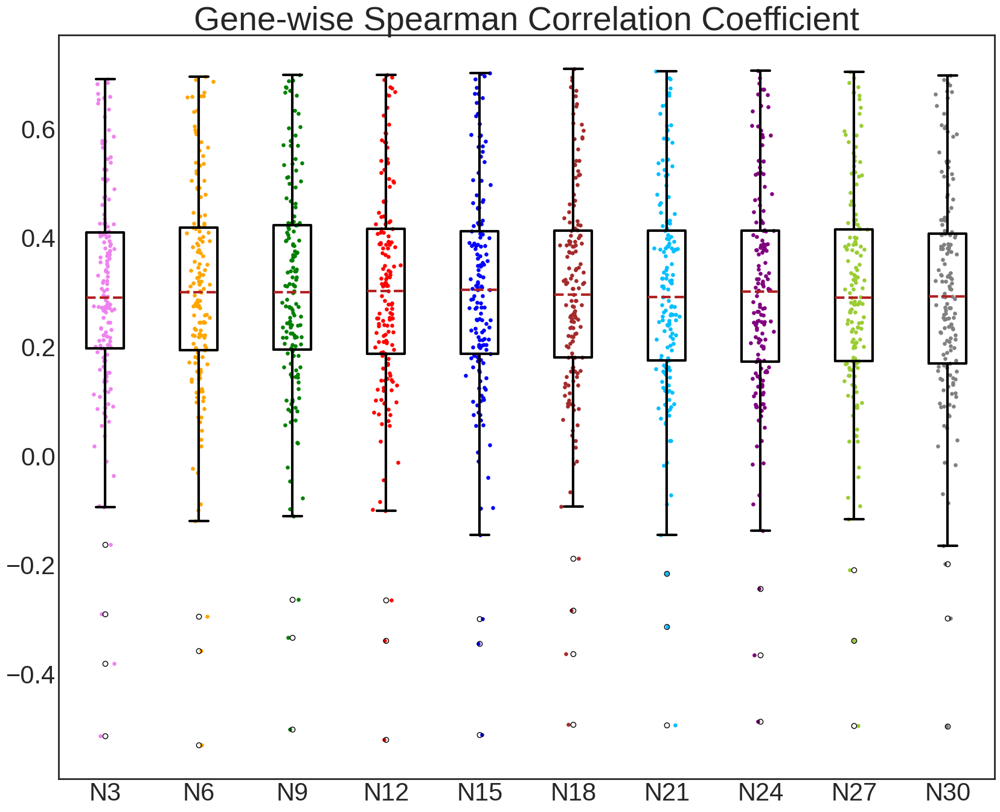

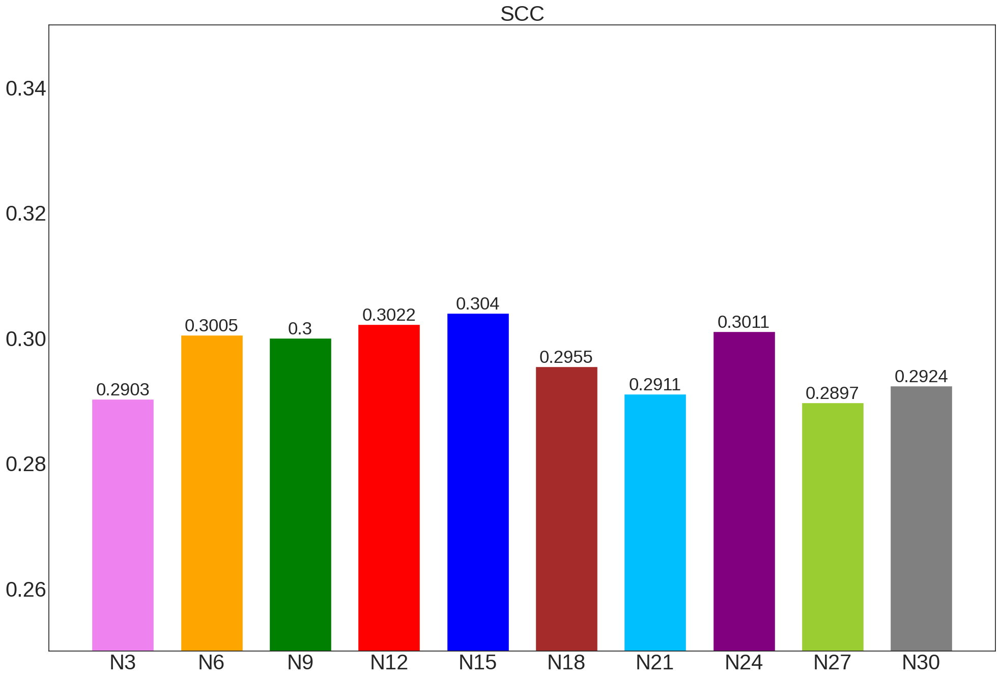

===> Fig2F


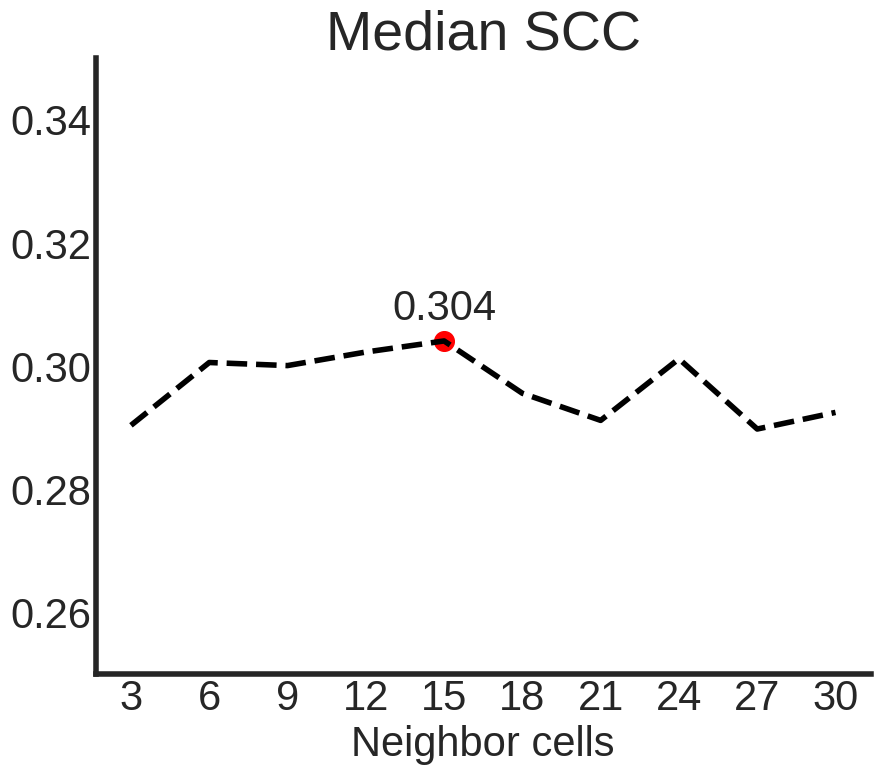

In [10]:
# Fig2F and its data.
'''
===> DAGCN median SCC and RMSE: 0.3040, 0.4981
===> DAGCN N3 median SCC and RMSE: 0.2903, 0.5051
===> DAGCN N6 median SCC and RMSE: 0.3005, 0.5052
===> DAGCN N9 median SCC and RMSE: 0.3000, 0.5081
===> DAGCN N12 median SCC and RMSE: 0.3022, 0.5097
===> DAGCN N18 median SCC and RMSE: 0.2955, 0.5035
===> DAGCN N21 median SCC and RMSE: 0.2911, 0.5076
===> DAGCN N24 median SCC and RMSE: 0.3011, 0.5052
===> DAGCN N27 median SCC and RMSE: 0.2897, 0.5115
===> DAGCN N30 median SCC and RMSE: 0.2924, 0.5073

===> Data of Fig2F was saved in /data/bioinf/jyuan/rongboshen/SpaGDA/draw_fig2/Moffit/neighbor/SCC_df.csv
===> Fig2F
'''




# Set arguments and hyper-parameters.

dataset = 'Moffit'
data_dir = '/data/bioinf/jyuan/rongboshen/SpaGDA/results/imputation'
save_dir = '/data/bioinf/jyuan/rongboshen/SpaGDA/draw_fig2/' 

sub_save_dir = os.path.join(save_dir, dataset, 'neighbor')
if not os.path.exists(sub_save_dir): os.mkdir(sub_save_dir)

sub_results_dir = os.path.join(data_dir, dataset, 'neighbor')
fs = open(os.path.join(sub_save_dir, 'metrics.txt'), 'w')

######## DAGCN hyperparameters: neighbor cells (3,6,9,12,15,18,21,24,27,30)
gimVI_imputed = pd.read_csv(os.path.join(data_dir, dataset, 'gimVI_FiveFolds.csv'), header=0, index_col=0, sep=',')
Gene_Order = gimVI_imputed.columns.to_list()

MERFISH_adata = sc.read(os.path.join(data_dir, dataset, 'MERFISH1.h5ad'))
MERFISH_adata = MERFISH_adata[:,Gene_Order]
MERFISH_df = pd.DataFrame(MERFISH_adata.X, columns=Gene_Order)


#neighbor cells: 15
DAGCN_imputed = pd.read_csv(os.path.join(data_dir, dataset, 'gan_DAGAN_FiveFolds_2022-09-10-13-02-13.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed = DAGCN_imputed[Gene_Order]

DAGCN_SCC = pd.Series(index = Gene_Order, dtype='float16', name='N15')
for i in Gene_Order:
    DAGCN_SCC[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed[i])[0]
DAGCN_RMSE = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed.to_numpy())
print('===> DAGCN median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC.median(), DAGCN_RMSE))
fs.write('===> DAGCN N15 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC.median(), DAGCN_RMSE))

#neighbor cells: 3
DAGCN_imputed3 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-10-11-16-07.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed3 = DAGCN_imputed3[Gene_Order]

DAGCN_SCC3 = pd.Series(index = Gene_Order, dtype='float16', name='N3')
for i in Gene_Order:
    DAGCN_SCC3[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed3[i])[0]
DAGCN_RMSE3 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed3.to_numpy())
print('===> DAGCN N3 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC3.median(), DAGCN_RMSE3))
fs.write('===> DAGCN N3 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC3.median(), DAGCN_RMSE3))


#neighbor cells: 6
DAGCN_imputed6 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-07-09-49-26.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed6 = DAGCN_imputed6[Gene_Order]

DAGCN_SCC6 = pd.Series(index = Gene_Order, dtype='float16', name='N6')
for i in Gene_Order:
    DAGCN_SCC6[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed6[i])[0]
DAGCN_RMSE6 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed6.to_numpy())
print('===> DAGCN N6 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC6.median(), DAGCN_RMSE6))
fs.write('===> DAGCN N6 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC6.median(), DAGCN_RMSE6))

#neighbor cells: 9
DAGCN_imputed9 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-07-12-06-12.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed9 = DAGCN_imputed9[Gene_Order]

DAGCN_SCC9 = pd.Series(index = Gene_Order, dtype='float16', name='N9')
for i in Gene_Order:
    DAGCN_SCC9[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed9[i])[0]
DAGCN_RMSE9 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed9.to_numpy())
print('===> DAGCN N9 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC9.median(), DAGCN_RMSE9))
fs.write('===> DAGCN N9 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC9.median(), DAGCN_RMSE9))

#neighbor cells: 12
DAGCN_imputed12 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-07-15-19-33.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed12 = DAGCN_imputed12[Gene_Order]

DAGCN_SCC12 = pd.Series(index = Gene_Order, dtype='float16', name='N12')
for i in Gene_Order:
    DAGCN_SCC12[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed12[i])[0]
DAGCN_RMSE12 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed12.to_numpy())
print('===> DAGCN N12 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC12.median(), DAGCN_RMSE12))
fs.write('===> DAGCN N12 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC12.median(), DAGCN_RMSE12))

#neighbor cells: 18
DAGCN_imputed18 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-08-00-33-22.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed18 = DAGCN_imputed18[Gene_Order]

DAGCN_SCC18 = pd.Series(index = Gene_Order, dtype='float16', name='N18')
for i in Gene_Order:
    DAGCN_SCC18[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed18[i])[0]
DAGCN_RMSE18 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed18.to_numpy())
print('===> DAGCN N18 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC18.median(), DAGCN_RMSE18))
fs.write('===> DAGCN N18 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC18.median(), DAGCN_RMSE18))

#neighbor cells: 21
DAGCN_imputed21 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-08-16-09-50.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed21 = DAGCN_imputed21[Gene_Order] #122

DAGCN_SCC21 = pd.Series(index = Gene_Order, dtype='float16', name='N21')
for i in Gene_Order:
    DAGCN_SCC21[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed21[i])[0]
DAGCN_RMSE21 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed21.to_numpy())
print('===> DAGCN N21 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC21.median(), DAGCN_RMSE21))
fs.write('===> DAGCN N21 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC21.median(), DAGCN_RMSE21))

#neighbor cells: 24
DAGCN_imputed24 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-08-18-54-56.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed24 = DAGCN_imputed24[Gene_Order] # 131

DAGCN_SCC24 = pd.Series(index = Gene_Order, dtype='float16', name='N24')
for i in Gene_Order:
    DAGCN_SCC24[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed24[i])[0]
DAGCN_RMSE24 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed24.to_numpy())
print('===> DAGCN N24 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC24.median(), DAGCN_RMSE24))
fs.write('===> DAGCN N24 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC24.median(), DAGCN_RMSE24))

#neighbor cells: 27
DAGCN_imputed27 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-09-00-34-19.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed27 = DAGCN_imputed27[Gene_Order] # 153

DAGCN_SCC27 = pd.Series(index = Gene_Order, dtype='float16', name='N27')
for i in Gene_Order:
    DAGCN_SCC27[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed27[i])[0]
DAGCN_RMSE27 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed27.to_numpy())
print('===> DAGCN N27 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC27.median(), DAGCN_RMSE27))
fs.write('===> DAGCN N27 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC27.median(), DAGCN_RMSE27))

#neighbor cells: 30
DAGCN_imputed30 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2022-10-09-03-41-47.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed30 = DAGCN_imputed30[Gene_Order] # 163

DAGCN_SCC30 = pd.Series(index = Gene_Order, dtype='float16', name='N30')
for i in Gene_Order:
    DAGCN_SCC30[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed30[i])[0]
DAGCN_RMSE30 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed30.to_numpy())
print('===> DAGCN N30 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC30.median(), DAGCN_RMSE30))
fs.write('===> DAGCN N30 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC30.median(), DAGCN_RMSE30))


####### Plot
labels = ['N3', 'N6', 'N9', 'N12', 'N15', 'N18', 'N21', 'N24', 'N27', 'N30']
compares = ['N3', 'N6', 'N9', 'N12', 'N18', 'N21', 'N24', 'N27', 'N30']
SCC_list = [DAGCN_SCC3, DAGCN_SCC6, DAGCN_SCC9, DAGCN_SCC12, DAGCN_SCC, DAGCN_SCC18, DAGCN_SCC21, DAGCN_SCC24, DAGCN_SCC27, DAGCN_SCC30]

my_pal = {"N3":"violet", "N6":"orange", "N9":"green", "N12":"red", "N15":"blue", "N18":"brown", "N21":"deepskyblue", "N24":"purple", "N27":"yellowgreen", "N30":"gray"}
SCC_df = pd.concat(SCC_list, axis=1)
print(SCC_df.columns, SCC_df.shape)
SCC_df.to_csv(os.path.join(sub_save_dir,'SCC_df.csv'))
print('===> Data of Fig2F was saved in %s/SCC_df.csv'%sub_save_dir)

# draw violin and box
#draw_violin(df=SCC_df, my_pal=my_pal, save_dir=sub_save_dir, name=args.dataset)
#draw_box(df=SCC_df, my_pal=my_pal, save_dir=sub_save_dir, name=args.dataset)

# plots all scc
plt.style.use('seaborn-white')
fig, ax = plt.subplots(figsize=(20, 16))

ax.spines.top.set_linewidth(2)
ax.spines.bottom.set_linewidth(2)
ax.spines.left.set_linewidth(2)
ax.spines.right.set_linewidth(2)

boxprops = dict(linewidth=3)
medianprops = dict(linestyle='--', linewidth=3, color='firebrick')
whiskerprops = dict(linewidth=3)
capprops = dict(linewidth=3)

ax.boxplot(SCC_list, labels=labels, widths = 0.4, boxprops=boxprops, medianprops=medianprops, whiskerprops=whiskerprops, capprops=capprops)
for i,y in enumerate(SCC_list):
    x = np.random.normal(i+1, 0.05, len(y))
    ax.scatter(x, y, c=my_pal[labels[i]], marker='o', s=14, label='%s: %.4f'%(labels[i],y.median()))
#ax.legend(loc=1, prop={'size': 9})
ax.tick_params(axis='x', labelsize=30)
ax.tick_params(axis='y', labelsize=30)
ax.set_title('Gene-wise Spearman Correlation Coefficient', fontsize=40)
fig.savefig(os.path.join(sub_save_dir,'Gene_Spearman_Corr_neighbor.pdf'),  bbox_inches='tight')
plt.show()
plt.close()

'''
    ## Pair-wise compare correlations
    custom_params = {'font.size': 8.0, 'lines.linewidth': 2, 'legend.fontsize': 7,  'xtick.labelsize': 10, 'ytick.labelsize': 10,}
    sns.set_theme(style="white", rc=custom_params)
    for method in compares:
        slope, intercept, r_value, p_value, std_err = st.linregress(SCC_df['N15'],SCC_df[method])
        _,p_val = st.wilcoxon(SCC_df['N15'],SCC_df[method])

        g = sns.JointGrid(x="N15", y=method, data=SCC_df, space=0.1, marginal_ticks=True, xlim=[-0.59,0.79], ylim=[-0.59,0.79])
        g = g.plot_joint(sns.regplot, line_kws={'color': my_pal[method], 'linewidth': 2, 'label':'R\u00b2:%.2f \nslope: %.2f \np_val: %.2e'%(r_value*r_value,slope,p_val)}, 
                                      scatter_kws={'color': my_pal[method], 's': 12, 'linewidths': 0.1})

        #g = sns.jointplot(x="DAGCN", y=method, data=SCC_df, kind="reg", space=0.1, color=my_pal[method], 
        #                  marginal_ticks=True, xlim=[-0.55,0.75], ylim=[-0.55,0.75],
        #                  joint_kws={'line_kws': {'color': my_pal[method], 'linewidth': 2, 'label':'slope: %.2f, p_val: %.2e'%(slope,p_val)}, 
        #                  'scatter_kws':{'s': 12, 'linewidths': 0.1}},
        #                  marginal_kws={'color': my_pal[method]})
        ax1 = g.ax_joint
        ax1.axline((0, 0), slope=1, color='black', linewidth=1, linestyle='--')
        ax1.legend(fontsize=12)

        axx = g.ax_marg_x
        axy = g.ax_marg_y
        sns.histplot(SCC_df, color=my_pal['N15'], x='N15', ax=axx, kde=True)
        sns.histplot(SCC_df, color=my_pal[method], y=method, ax=axy, kde=True)

        #axx.legend(['DAGCN median: %.4f'%SCC_df['DAGCN'].median()], loc=2, fontsize=8)
        #axy.legend(['%s median: %.4f'%(method, SCC_df[method].median())], loc=1, fontsize=8)

        g.savefig(os.path.join(sub_save_dir, 'neighbor_compare_%s.pdf'%method), bbox_inches='tight')
        plt.close()
'''

##SCC
fig, ax = plt.subplots(figsize=(24,16))
col = ['gray'] * 10
col[4] = 'blue'
scc_list = [0.2903, 0.3005, 0.3000, 0.3022, 0.3040, 0.2955, 0.2911, 0.3011, 0.2897, 0.2924]
ax.bar(labels, scc_list, color=[my_pal[i] for i in labels], width = 0.7)
for a,b in zip(labels, scc_list):
    ax.text(a,b,
            b,
            ha='center', 
            va='bottom', fontsize=25
            )

ax.tick_params(axis='x', labelsize=30)
ax.tick_params(axis='y', labelsize=30)
ax.set_title('SCC',  fontsize=30)
ax.set_ylim(0.25, 0.35)

fig.savefig(os.path.join(sub_save_dir, 'neighbor_bar_SCC.pdf'), bbox_inches='tight')
plt.show()
plt.close()

print('===> Fig2F')
# SCC curve
fig, ax = plt.subplots(figsize=(10,8))
labels_num = ['3', '6', '9', '12', '15', '18', '21', '24', '27', '30']
ax.spines[['top', 'right']].set_visible(False)
ax.spines[['bottom','left']].set_linewidth(4)
ax.plot(labels_num, scc_list, color = 'black', linewidth=4, linestyle='--')
ax.scatter('15',0.3040, s=200, c='red', marker='o')
ax.text('15',0.3040+0.002,
            0.3040,
            ha='center', 
            va='bottom', fontsize=30
            )
ax.tick_params(axis='x', labelsize=30)
ax.tick_params(axis='y', labelsize=30)
ax.set_title('Median SCC', fontsize=40) 
ax.set_xlabel('Neighbor cells',fontsize=30)
ax.set_ylim(0.25, 0.35)
fig.savefig(os.path.join(sub_save_dir, 'neighbor_curve_SCC.pdf'), bbox_inches='tight')
plt.show()
plt.close()

===> DAGCN median SCC and RMSE: 0.3905, 0.4194
===> DAGCN N1 median SCC and RMSE: 0.3425, 0.4178
===> DAGCN N3 median SCC and RMSE: 0.3830, 0.4378
===> DAGCN N6 median SCC and RMSE: 0.3843, 0.3930
===> DAGCN N9 median SCC and RMSE: 0.3763, 0.4278
===> DAGCN N12 median SCC and RMSE: 0.3910, 0.4382
===> DAGCN N18 median SCC and RMSE: 0.3806, 0.4251
===> DAGCN N21 median SCC and RMSE: 0.3909, 0.4030
===> DAGCN N24 median SCC and RMSE: 0.3889, 0.4483
===> DAGCN N27 median SCC and RMSE: 0.3813, 0.3989
===> DAGCN N30 median SCC and RMSE: 0.3835, 0.4398
Index(['N1', 'N3', 'N6', 'N9', 'N12', 'N15', 'N18', 'N21', 'N24', 'N27',
       'N30'],
      dtype='object') (252, 11)
===> Data was saved in /data/bioinf/jyuan/rongboshen/SpaGDA/draw_fig2/Mop/neighbor/SCC_df.csv


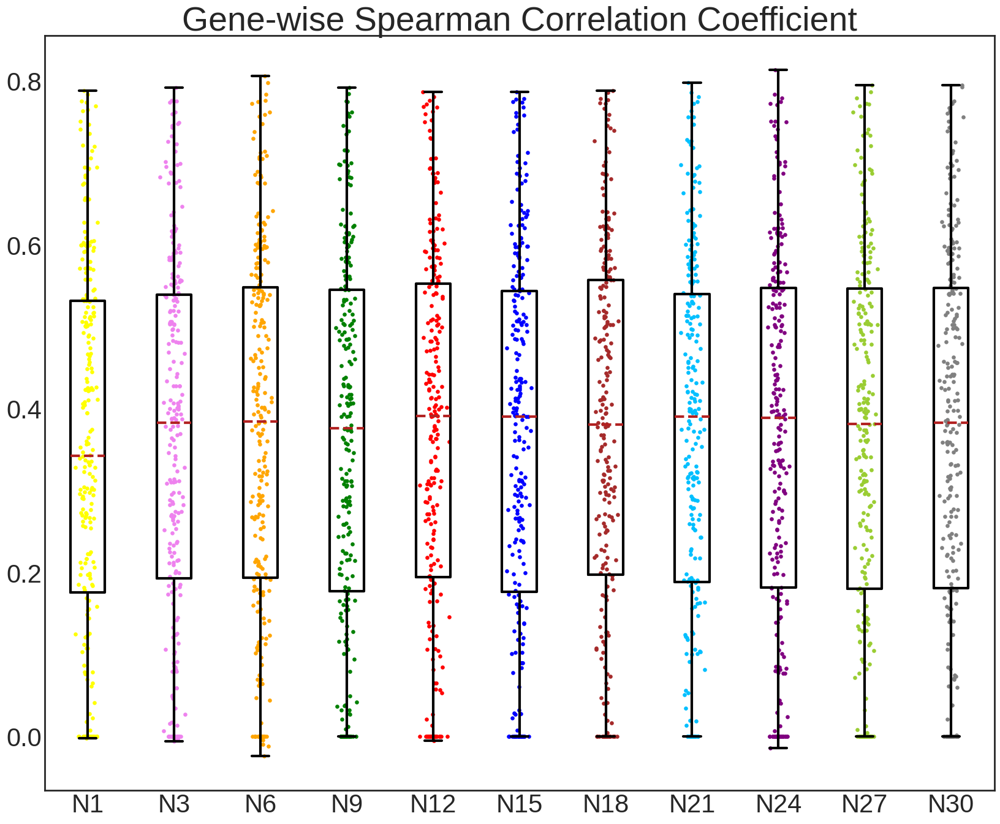

===> Fig2F candidate


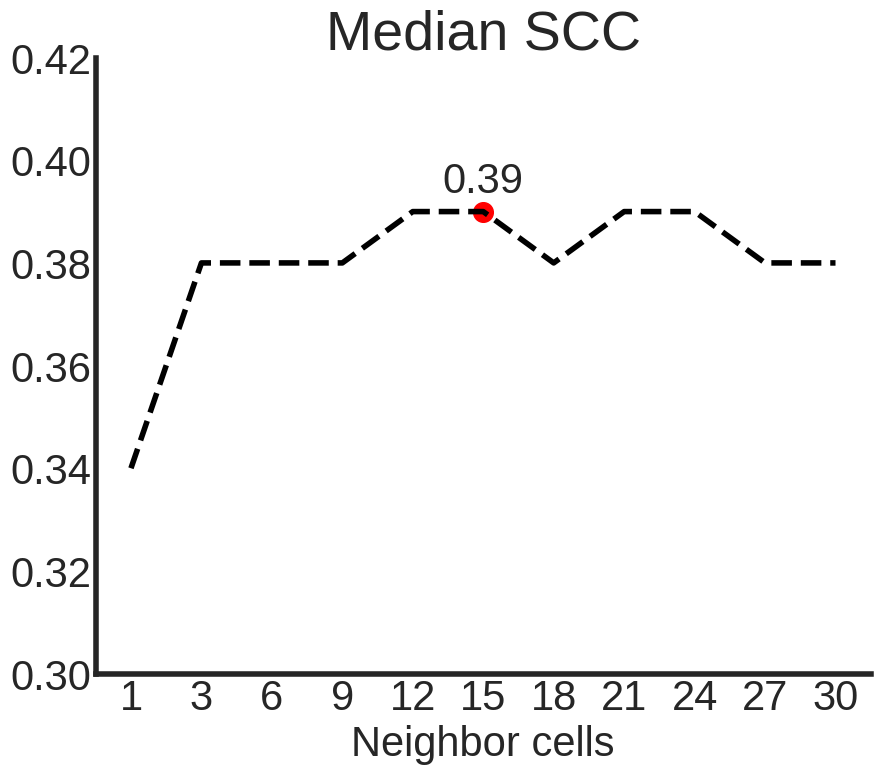

In [11]:
# Append robustness test for Mop dataset with different neighbor cells.

'''
===> Fig2F candidate

'''

# Set arguments and hyper-parameters.

dataset = 'Mop'
data_dir = '/data/bioinf/jyuan/rongboshen/SpaGDA/results/imputation'
save_dir = '/data/bioinf/jyuan/rongboshen/SpaGDA/draw_fig2/' 

sub_save_dir = os.path.join(save_dir, dataset, 'neighbor')
if not os.path.exists(sub_save_dir): os.mkdir(sub_save_dir)

sub_results_dir = os.path.join(data_dir, dataset, 'neighbor')
fs = open(os.path.join(sub_save_dir, 'metrics.txt'), 'w')

######## DAGCN hyperparameters: neighbor cells (3,6,9,12,15,18,21,24,27,30)
gimVI_imputed = pd.read_csv(os.path.join(data_dir, dataset, 'gimVI_FiveFolds.csv'), header=0, index_col=0, sep=',')
Gene_Order = gimVI_imputed.columns.to_list()

MERFISH_adata = sc.read(os.path.join(data_dir, dataset, 'MERFISH.h5ad'))
MERFISH_adata = MERFISH_adata[:,Gene_Order]
MERFISH_df = pd.DataFrame(MERFISH_adata.X, columns=Gene_Order)


#neighbor cells: 15
DAGCN_imputed = pd.read_csv(os.path.join(data_dir, dataset, 'gan_DAGAN_FiveFolds_2022-09-10-15-48-34.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed = DAGCN_imputed[Gene_Order]

DAGCN_SCC = pd.Series(index = Gene_Order, dtype='float16', name='N15')
for i in Gene_Order:
    if np.std(DAGCN_imputed[i]) == 0:
        DAGCN_SCC[i] = 0
    else:
        DAGCN_SCC[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed[i])[0]
DAGCN_RMSE = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed.to_numpy())
print('===> DAGCN median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC.median(), DAGCN_RMSE))
fs.write('===> DAGCN N15 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC.median(), DAGCN_RMSE))

#neighbor cells: 1
DAGCN_imputed1 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-09-27-13-15-36.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed1 = DAGCN_imputed1[Gene_Order]

DAGCN_SCC1 = pd.Series(index = Gene_Order, dtype='float16', name='N1')
for i in Gene_Order:
    if np.std(DAGCN_imputed1[i]) == 0:
        DAGCN_SCC1[i] = 0
    else:
        DAGCN_SCC1[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed1[i])[0]
DAGCN_RMSE1 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed1.to_numpy())
print('===> DAGCN N1 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC1.median(), DAGCN_RMSE1))
fs.write('===> DAGCN N1 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC1.median(), DAGCN_RMSE1))

#neighbor cells: 3
DAGCN_imputed3 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-09-26-21-20-24.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed3 = DAGCN_imputed3[Gene_Order]

DAGCN_SCC3 = pd.Series(index = Gene_Order, dtype='float16', name='N3')
for i in Gene_Order:
    if np.std(DAGCN_imputed3[i]) == 0:
        DAGCN_SCC3[i] = 0
    else:
        DAGCN_SCC3[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed3[i])[0]
DAGCN_RMSE3 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed3.to_numpy())
print('===> DAGCN N3 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC3.median(), DAGCN_RMSE3))
fs.write('===> DAGCN N3 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC3.median(), DAGCN_RMSE3))


#neighbor cells: 6
DAGCN_imputed6 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-09-26-13-09-36.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed6 = DAGCN_imputed6[Gene_Order]

DAGCN_SCC6 = pd.Series(index = Gene_Order, dtype='float16', name='N6')
for i in Gene_Order:
    if np.std(DAGCN_imputed6[i]) == 0:
        DAGCN_SCC6[i] = 0
    else:
        DAGCN_SCC6[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed6[i])[0]
DAGCN_RMSE6 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed6.to_numpy())
print('===> DAGCN N6 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC6.median(), DAGCN_RMSE6))
fs.write('===> DAGCN N6 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC6.median(), DAGCN_RMSE6))

#neighbor cells: 9
DAGCN_imputed9 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-09-25-18-26-33.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed9 = DAGCN_imputed9[Gene_Order]

DAGCN_SCC9 = pd.Series(index = Gene_Order, dtype='float16', name='N9')
for i in Gene_Order:
    if np.std(DAGCN_imputed9[i]) == 0:
        DAGCN_SCC9[i] = 0
    else:
        DAGCN_SCC9[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed9[i])[0]
DAGCN_RMSE9 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed9.to_numpy())
print('===> DAGCN N9 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC9.median(), DAGCN_RMSE9))
fs.write('===> DAGCN N9 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC9.median(), DAGCN_RMSE9))

#neighbor cells: 12
DAGCN_imputed12 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-09-22-21-24-34.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed12 = DAGCN_imputed12[Gene_Order]

DAGCN_SCC12 = pd.Series(index = Gene_Order, dtype='float16', name='N12')
for i in Gene_Order:
    if np.std(DAGCN_imputed12[i]) == 0:
        DAGCN_SCC12[i] = 0
    else:
        DAGCN_SCC12[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed12[i])[0]
DAGCN_RMSE12 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed12.to_numpy())
print('===> DAGCN N12 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC12.median(), DAGCN_RMSE12))
fs.write('===> DAGCN N12 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC12.median(), DAGCN_RMSE12))

#neighbor cells: 18
DAGCN_imputed18 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-09-27-20-19-56.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed18 = DAGCN_imputed18[Gene_Order]

DAGCN_SCC18 = pd.Series(index = Gene_Order, dtype='float16', name='N18')
for i in Gene_Order:
    if np.std(DAGCN_imputed18[i]) == 0:
        DAGCN_SCC18[i] = 0
    else:
        DAGCN_SCC18[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed18[i])[0]
DAGCN_RMSE18 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed18.to_numpy())
print('===> DAGCN N18 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC18.median(), DAGCN_RMSE18))
fs.write('===> DAGCN N18 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC18.median(), DAGCN_RMSE18))

#neighbor cells: 21
DAGCN_imputed21 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-09-28-15-32-49.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed21 = DAGCN_imputed21[Gene_Order] #122

DAGCN_SCC21 = pd.Series(index = Gene_Order, dtype='float16', name='N21')
for i in Gene_Order:
    if np.std(DAGCN_imputed21[i]) == 0:
        DAGCN_SCC21[i] = 0
    else:
        DAGCN_SCC21[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed21[i])[0]
DAGCN_RMSE21 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed21.to_numpy())
print('===> DAGCN N21 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC21.median(), DAGCN_RMSE21))
fs.write('===> DAGCN N21 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC21.median(), DAGCN_RMSE21))

#neighbor cells: 24
DAGCN_imputed24 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-04-17-16-13.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed24 = DAGCN_imputed24[Gene_Order] # 131

DAGCN_SCC24 = pd.Series(index = Gene_Order, dtype='float16', name='N24')
for i in Gene_Order:
    if np.std(DAGCN_imputed24[i]) == 0:
        DAGCN_SCC24[i] = 0
    else:
        DAGCN_SCC24[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed24[i])[0]
DAGCN_RMSE24 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed24.to_numpy())
print('===> DAGCN N24 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC24.median(), DAGCN_RMSE24))
fs.write('===> DAGCN N24 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC24.median(), DAGCN_RMSE24))

#neighbor cells: 27
DAGCN_imputed27 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-07-15-45-27.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed27 = DAGCN_imputed27[Gene_Order] # 153

DAGCN_SCC27 = pd.Series(index = Gene_Order, dtype='float16', name='N27')
for i in Gene_Order:
    if np.std(DAGCN_imputed27[i]) == 0:
        DAGCN_SCC27[i] = 0
    else:
        DAGCN_SCC27[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed27[i])[0]
DAGCN_RMSE27 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed27.to_numpy())
print('===> DAGCN N27 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC27.median(), DAGCN_RMSE27))
fs.write('===> DAGCN N27 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC27.median(), DAGCN_RMSE27))

#neighbor cells: 30
DAGCN_imputed30 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-07-23-53-14.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed30 = DAGCN_imputed30[Gene_Order] # 163

DAGCN_SCC30 = pd.Series(index = Gene_Order, dtype='float16', name='N30')
for i in Gene_Order:
    if np.std(DAGCN_imputed30[i]) == 0:
        DAGCN_SCC30[i] = 0
    else:
        DAGCN_SCC30[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed30[i])[0]
DAGCN_RMSE30 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed30.to_numpy())
print('===> DAGCN N30 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC30.median(), DAGCN_RMSE30))
fs.write('===> DAGCN N30 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC30.median(), DAGCN_RMSE30))


####### Plot
labels = ['N1', 'N3', 'N6', 'N9', 'N12', 'N15', 'N18', 'N21', 'N24', 'N27', 'N30']
compares = ['N1', 'N3', 'N6', 'N9', 'N12', 'N18', 'N21', 'N24', 'N27', 'N30']
SCC_list = [DAGCN_SCC1, DAGCN_SCC3, DAGCN_SCC6, DAGCN_SCC9, DAGCN_SCC12, DAGCN_SCC, 
            DAGCN_SCC18, DAGCN_SCC21, DAGCN_SCC24, DAGCN_SCC27, DAGCN_SCC30]

my_pal = {"N1":"yellow", "N3":"violet", "N6":"orange", "N9":"green", "N12":"red", "N15":"blue", 
          "N18":"brown", "N21":"deepskyblue", "N24":"purple", "N27":"yellowgreen", "N30":"gray"}
SCC_df = pd.concat(SCC_list, axis=1)
print(SCC_df.columns, SCC_df.shape)
SCC_df.to_csv(os.path.join(sub_save_dir,'SCC_df.csv'))
print('===> Data was saved in %s/SCC_df.csv'%sub_save_dir)

# draw violin and box
#draw_violin(df=SCC_df, my_pal=my_pal, save_dir=sub_save_dir, name=args.dataset)
#draw_box(df=SCC_df, my_pal=my_pal, save_dir=sub_save_dir, name=args.dataset)

# plots all scc
plt.style.use('seaborn-white')
fig, ax = plt.subplots(figsize=(20, 16))

ax.spines.top.set_linewidth(2)
ax.spines.bottom.set_linewidth(2)
ax.spines.left.set_linewidth(2)
ax.spines.right.set_linewidth(2)

boxprops = dict(linewidth=3)
medianprops = dict(linestyle='--', linewidth=3, color='firebrick')
whiskerprops = dict(linewidth=3)
capprops = dict(linewidth=3)

ax.boxplot(SCC_list, labels=labels, widths = 0.4, boxprops=boxprops, medianprops=medianprops, 
           whiskerprops=whiskerprops, capprops=capprops)
for i,y in enumerate(SCC_list):
    x = np.random.normal(i+1, 0.05, len(y))
    ax.scatter(x, y, c=my_pal[labels[i]], marker='o', s=14, label='%s: %.4f'%(labels[i],y.median()))
#ax.legend(loc=1, prop={'size': 9})
ax.tick_params(axis='x', labelsize=30)
ax.tick_params(axis='y', labelsize=30)
ax.set_title('Gene-wise Spearman Correlation Coefficient', fontsize=40)
fig.savefig(os.path.join(sub_save_dir,'Gene_Spearman_Corr_neighbor.pdf'),  bbox_inches='tight')
plt.show()
plt.close()


print('===> Fig2F candidate')
# SCC curve
fig, ax = plt.subplots(figsize=(10,8))
labels_num = ['1', '3', '6', '9', '12', '15', '18', '21', '24', '27', '30']
scc_list = [0.34, 0.38, 0.38, 0.38, 0.39, 0.39, 0.38, 0.39, 0.39, 0.38, 0.38]
ax.spines[['top', 'right']].set_visible(False)
ax.spines[['bottom','left']].set_linewidth(4)
ax.plot(labels_num, scc_list, color = 'black', linewidth=4, linestyle='--')
ax.scatter('15',0.39, s=200, c='red', marker='o')
ax.text('15',0.39+0.002,
            0.39,
            ha='center', 
            va='bottom', fontsize=30
            )
ax.tick_params(axis='x', labelsize=30)
ax.tick_params(axis='y', labelsize=30)
ax.set_title('Median SCC', fontsize=40) 
ax.set_xlabel('Neighbor cells',fontsize=30)
ax.set_ylim(0.30, 0.42)
fig.savefig(os.path.join(sub_save_dir, 'neighbor_curve_SCC.pdf'), bbox_inches='tight')
plt.show()
plt.close()


===> DAGCN S40 median SCC and RMSE: 0.3905, 0.4194
===> DAGCN S5 median SCC and RMSE: 0.3721, 0.4009
===> DAGCN S10 median SCC and RMSE: 0.3816, 0.4005
===> DAGCN S15 median SCC and RMSE: 0.3804, 0.4363
===> DAGCN S20 median SCC and RMSE: 0.3624, 0.4175
===> DAGCN S25 median SCC and RMSE: 0.3799, 0.4332
===> DAGCN S30 median SCC and RMSE: 0.3760, 0.3950
===> DAGCN S35 median SCC and RMSE: 0.3809, 0.4293
===> DAGCN S45 median SCC and RMSE: 0.3771, 0.4033
===> DAGCN S50 median SCC and RMSE: 0.3832, 0.4191
===> DAGCN S55 median SCC and RMSE: 0.3784, 0.4200
===> DAGCN S60 median SCC and RMSE: 0.3710, 0.4105
===> DAGCN S65 median SCC and RMSE: 0.3819, 0.4373
===> DAGCN S70 median SCC and RMSE: 0.3906, 0.4137
===> DAGCN S75 median SCC and RMSE: 0.3722, 0.4128
===> DAGCN S80 median SCC and RMSE: 0.3638, 0.4173
===> DAGCN S85 median SCC and RMSE: 0.3744, 0.4368
===> DAGCN S90 median SCC and RMSE: 0.3770, 0.4151
Index(['S5', 'S10', 'S15', 'S20', 'S25', 'S30', 'S35', 'S40', 'S45', 'S50',
       

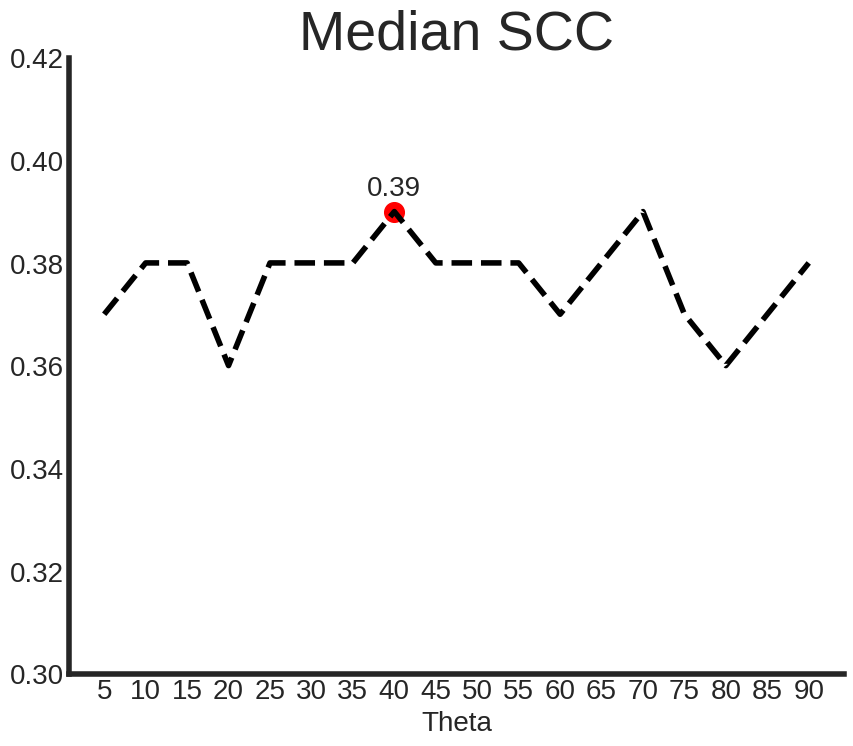

In [12]:
# Append robustness test for Mop dataset with different sigma parameters.

'''
===> Fig2G candidate

'''

# Set arguments and hyper-parameters.

dataset = 'Mop'
data_dir = '/data/bioinf/jyuan/rongboshen/SpaGDA/results/imputation'
save_dir = '/data/bioinf/jyuan/rongboshen/SpaGDA/draw_fig2/' 

sub_save_dir = os.path.join(save_dir, dataset, 'sigma')
if not os.path.exists(sub_save_dir): os.mkdir(sub_save_dir)

sub_results_dir = os.path.join(data_dir, dataset, 'sigma')
fs = open(os.path.join(sub_save_dir, 'metrics.txt'), 'w')

######## DAGCN hyperparameters: neighbor cells (3,6,9,12,15,18,21,24,27,30)
gimVI_imputed = pd.read_csv(os.path.join(data_dir, dataset, 'gimVI_FiveFolds.csv'), header=0, index_col=0, sep=',')
Gene_Order = gimVI_imputed.columns.to_list()

MERFISH_adata = sc.read(os.path.join(data_dir, dataset, 'MERFISH.h5ad'))
MERFISH_adata = MERFISH_adata[:,Gene_Order]
MERFISH_df = pd.DataFrame(MERFISH_adata.X, columns=Gene_Order)


#sigma: 40
DAGCN_imputed = pd.read_csv(os.path.join(data_dir, dataset, 'gan_DAGAN_FiveFolds_2022-09-10-15-48-34.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed = DAGCN_imputed[Gene_Order]

DAGCN_SCC = pd.Series(index = Gene_Order, dtype='float16', name='S40')
for i in Gene_Order:
    if np.std(DAGCN_imputed[i]) == 0:
        DAGCN_SCC[i] = 0
    else:
        DAGCN_SCC[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed[i])[0]
DAGCN_RMSE = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed.to_numpy())
print('===> DAGCN S40 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC.median(), DAGCN_RMSE))
fs.write('===> DAGCN S40 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC.median(), DAGCN_RMSE))

#sigma: 5
DAGCN_imputed5 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-11-12-53-57.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed5 = DAGCN_imputed5[Gene_Order]

DAGCN_SCC5 = pd.Series(index = Gene_Order, dtype='float16', name='S5')
for i in Gene_Order:
    if np.std(DAGCN_imputed5[i]) == 0:
        DAGCN_SCC5[i] = 0
    else:
        DAGCN_SCC5[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed5[i])[0]
DAGCN_RMSE5 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed5.to_numpy())
print('===> DAGCN S5 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC5.median(), DAGCN_RMSE5))
fs.write('===> DAGCN S5 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC5.median(), DAGCN_RMSE5))

#sigma: 10
DAGCN_imputed10 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-10-19-14-47.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed10 = DAGCN_imputed10[Gene_Order]

DAGCN_SCC10 = pd.Series(index = Gene_Order, dtype='float16', name='S10')
for i in Gene_Order:
    if np.std(DAGCN_imputed10[i]) == 0:
        DAGCN_SCC10[i] = 0
    else:
        DAGCN_SCC10[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed10[i])[0]
DAGCN_RMSE10 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed10.to_numpy())
print('===> DAGCN S10 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC10.median(), DAGCN_RMSE10))
fs.write('===> DAGCN S10 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC10.median(), DAGCN_RMSE10))

#sigma: 15
DAGCN_imputed15 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-10-14-13-02.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed15 = DAGCN_imputed15[Gene_Order]

DAGCN_SCC15 = pd.Series(index = Gene_Order, dtype='float16', name='S15')
for i in Gene_Order:
    if np.std(DAGCN_imputed15[i]) == 0:
        DAGCN_SCC15[i] = 0
    else:
        DAGCN_SCC15[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed15[i])[0]
DAGCN_RMSE15 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed15.to_numpy())
print('===> DAGCN S15 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC15.median(), DAGCN_RMSE15))
fs.write('===> DAGCN S15 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC15.median(), DAGCN_RMSE15))

#sigma: 20
DAGCN_imputed20 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-09-20-34-29.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed20 = DAGCN_imputed20[Gene_Order]

DAGCN_SCC20 = pd.Series(index = Gene_Order, dtype='float16', name='S20')
for i in Gene_Order:
    if np.std(DAGCN_imputed20[i]) == 0:
        DAGCN_SCC20[i] = 0
    else:
        DAGCN_SCC20[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed20[i])[0]
DAGCN_RMSE20 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed20.to_numpy())
print('===> DAGCN S20 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC20.median(), DAGCN_RMSE20))
fs.write('===> DAGCN S20 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC20.median(), DAGCN_RMSE20))

#sigma: 25
DAGCN_imputed25 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-27-19-45-34.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed25 = DAGCN_imputed25[Gene_Order]

DAGCN_SCC25 = pd.Series(index = Gene_Order, dtype='float16', name='S25')
for i in Gene_Order:
    if np.std(DAGCN_imputed25[i]) == 0:
        DAGCN_SCC25[i] = 0
    else:
        DAGCN_SCC25[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed25[i])[0]
DAGCN_RMSE25 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed25.to_numpy())
print('===> DAGCN S25 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC25.median(), DAGCN_RMSE25))
fs.write('===> DAGCN S25 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC25.median(), DAGCN_RMSE25))

#sigma: 30
DAGCN_imputed30 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-08-20-47-11.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed30 = DAGCN_imputed30[Gene_Order]

DAGCN_SCC30 = pd.Series(index = Gene_Order, dtype='float16', name='S30')
for i in Gene_Order:
    if np.std(DAGCN_imputed30[i]) == 0:
        DAGCN_SCC30[i] = 0
    else:
        DAGCN_SCC30[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed30[i])[0]
DAGCN_RMSE30 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed30.to_numpy())
print('===> DAGCN S30 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC30.median(), DAGCN_RMSE30))
fs.write('===> DAGCN S30 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC30.median(), DAGCN_RMSE30))

#sigma: 35
DAGCN_imputed35 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-08-14-52-08.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed35 = DAGCN_imputed35[Gene_Order]

DAGCN_SCC35 = pd.Series(index = Gene_Order, dtype='float16', name='S35')
for i in Gene_Order:
    if np.std(DAGCN_imputed35[i]) == 0:
        DAGCN_SCC35[i] = 0
    else:
        DAGCN_SCC35[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed35[i])[0]
DAGCN_RMSE35 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed35.to_numpy())
print('===> DAGCN S35 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC35.median(), DAGCN_RMSE35))
fs.write('===> DAGCN S35 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC35.median(), DAGCN_RMSE35))

#sigma: 45
DAGCN_imputed45 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-11-21-01-29.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed45 = DAGCN_imputed45[Gene_Order]

DAGCN_SCC45 = pd.Series(index = Gene_Order, dtype='float16', name='S45')
for i in Gene_Order:
    if np.std(DAGCN_imputed45[i]) == 0:
        DAGCN_SCC45[i] = 0
    else:
        DAGCN_SCC45[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed45[i])[0]
DAGCN_RMSE45 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed45.to_numpy())
print('===> DAGCN S45 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC45.median(), DAGCN_RMSE45))
fs.write('===> DAGCN S45 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC45.median(), DAGCN_RMSE45))

#sigma: 50
DAGCN_imputed50 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-12-23-09-56.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed50 = DAGCN_imputed50[Gene_Order]

DAGCN_SCC50 = pd.Series(index = Gene_Order, dtype='float16', name='S50')
for i in Gene_Order:
    if np.std(DAGCN_imputed50[i]) == 0:
        DAGCN_SCC50[i] = 0
    else:
        DAGCN_SCC50[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed50[i])[0]
DAGCN_RMSE50 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed50.to_numpy())
print('===> DAGCN S50 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC50.median(), DAGCN_RMSE50))
fs.write('===> DAGCN S50 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC50.median(), DAGCN_RMSE50))

#sigma: 55
DAGCN_imputed55 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-13-16-10-09.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed55 = DAGCN_imputed55[Gene_Order]

DAGCN_SCC55 = pd.Series(index = Gene_Order, dtype='float16', name='S55')
for i in Gene_Order:
    if np.std(DAGCN_imputed55[i]) == 0:
        DAGCN_SCC55[i] = 0
    else:
        DAGCN_SCC55[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed55[i])[0]
DAGCN_RMSE55 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed55.to_numpy())
print('===> DAGCN S55 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC55.median(), DAGCN_RMSE55))
fs.write('===> DAGCN S55 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC55.median(), DAGCN_RMSE55))

#sigma: 60
DAGCN_imputed60 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-13-23-01-20.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed60 = DAGCN_imputed60[Gene_Order]

DAGCN_SCC60 = pd.Series(index = Gene_Order, dtype='float16', name='S60')
for i in Gene_Order:
    if np.std(DAGCN_imputed60[i]) == 0:
        DAGCN_SCC60[i] = 0
    else:
        DAGCN_SCC60[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed60[i])[0]
DAGCN_RMSE60 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed60.to_numpy())
print('===> DAGCN S60 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC60.median(), DAGCN_RMSE60))
fs.write('===> DAGCN S60 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC60.median(), DAGCN_RMSE60))

#sigma: 65
DAGCN_imputed65 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-16-21-25-03.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed65 = DAGCN_imputed65[Gene_Order]

DAGCN_SCC65 = pd.Series(index = Gene_Order, dtype='float16', name='S65')
for i in Gene_Order:
    if np.std(DAGCN_imputed65[i]) == 0:
        DAGCN_SCC65[i] = 0
    else:
        DAGCN_SCC65[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed65[i])[0]
DAGCN_RMSE65 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed65.to_numpy())
print('===> DAGCN S65 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC65.median(), DAGCN_RMSE65))
fs.write('===> DAGCN S65 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC65.median(), DAGCN_RMSE65))

#sigma: 70
DAGCN_imputed70 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-17-14-15-23.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed70 = DAGCN_imputed70[Gene_Order]

DAGCN_SCC70 = pd.Series(index = Gene_Order, dtype='float16', name='S70')
for i in Gene_Order:
    if np.std(DAGCN_imputed70[i]) == 0:
        DAGCN_SCC70[i] = 0
    else:
        DAGCN_SCC70[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed70[i])[0]
DAGCN_RMSE70 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed70.to_numpy())
print('===> DAGCN S70 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC70.median(), DAGCN_RMSE70))
fs.write('===> DAGCN S70 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC70.median(), DAGCN_RMSE70))

#sigma: 75
DAGCN_imputed75 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-18-17-36-16.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed75 = DAGCN_imputed75[Gene_Order]

DAGCN_SCC75 = pd.Series(index = Gene_Order, dtype='float16', name='S75')
for i in Gene_Order:
    if np.std(DAGCN_imputed75[i]) == 0:
        DAGCN_SCC75[i] = 0
    else:
        DAGCN_SCC75[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed75[i])[0]
DAGCN_RMSE75 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed75.to_numpy())
print('===> DAGCN S75 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC75.median(), DAGCN_RMSE75))
fs.write('===> DAGCN S75 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC75.median(), DAGCN_RMSE75))

#sigma: 80
DAGCN_imputed80 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-19-00-10-21.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed80 = DAGCN_imputed80[Gene_Order]

DAGCN_SCC80 = pd.Series(index = Gene_Order, dtype='float16', name='S80')
for i in Gene_Order:
    if np.std(DAGCN_imputed80[i]) == 0:
        DAGCN_SCC80[i] = 0
    else:
        DAGCN_SCC80[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed80[i])[0]
DAGCN_RMSE80 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed80.to_numpy())
print('===> DAGCN S80 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC80.median(), DAGCN_RMSE80))
fs.write('===> DAGCN S80 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC80.median(), DAGCN_RMSE80))

#sigma: 85
DAGCN_imputed85 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-19-14-54-15.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed85 = DAGCN_imputed85[Gene_Order]

DAGCN_SCC85 = pd.Series(index = Gene_Order, dtype='float16', name='S85')
for i in Gene_Order:
    if np.std(DAGCN_imputed85[i]) == 0:
        DAGCN_SCC85[i] = 0
    else:
        DAGCN_SCC85[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed85[i])[0]
DAGCN_RMSE85 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed85.to_numpy())
print('===> DAGCN S85 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC85.median(), DAGCN_RMSE85))
fs.write('===> DAGCN S85 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC85.median(), DAGCN_RMSE85))

#sigma: 90
DAGCN_imputed90 = pd.read_csv(os.path.join(sub_results_dir, 'gan_DAGAN_FiveFolds_2023-10-19-21-16-41.csv'), header=0, index_col=0, sep=',')
DAGCN_imputed90 = DAGCN_imputed90[Gene_Order]

DAGCN_SCC90 = pd.Series(index = Gene_Order, dtype='float16', name='S90')
for i in Gene_Order:
    if np.std(DAGCN_imputed90[i]) == 0:
        DAGCN_SCC90[i] = 0
    else:
        DAGCN_SCC90[i] = st.spearmanr(MERFISH_df[i], DAGCN_imputed90[i])[0]
DAGCN_RMSE90 = mean_squared_error(MERFISH_df.to_numpy(), DAGCN_imputed90.to_numpy())
print('===> DAGCN S90 median SCC and RMSE: %.4f, %.4f'%(DAGCN_SCC90.median(), DAGCN_RMSE90))
fs.write('===> DAGCN S90 median SCC and RMSE: %.4f, %.4f\n'%(DAGCN_SCC90.median(), DAGCN_RMSE90))

####### Plot
labels = ['S5', 'S10', 'S15', 'S20', 'S25', 'S30', 'S35', 'S40', 'S45', 
          'S50', 'S55', 'S60', 'S65', 'S70', 'S75', 'S80', 'S85', 'S90',]

SCC_list = [DAGCN_SCC5, DAGCN_SCC10, DAGCN_SCC15, DAGCN_SCC20, DAGCN_SCC25, DAGCN_SCC30, 
            DAGCN_SCC35, DAGCN_SCC, DAGCN_SCC45, DAGCN_SCC50, DAGCN_SCC55, DAGCN_SCC60, 
            DAGCN_SCC65, DAGCN_SCC70, DAGCN_SCC75, DAGCN_SCC80, DAGCN_SCC85, DAGCN_SCC90]


SCC_df = pd.concat(SCC_list, axis=1)
print(SCC_df.columns, SCC_df.shape)
SCC_df.to_csv(os.path.join(sub_save_dir,'SCC_df.csv'))
print('===> Data was saved in %s/SCC_df.csv'%sub_save_dir)



print('===> Fig2G candidate')
# SCC curve
fig, ax = plt.subplots(figsize=(10,8))
labels_num = ['5', '10', '15', '20', '25', '30', '35', '40', '45', 
              '50', '55', '60', '65', '70', '75', '80', '85', '90']
scc_list = [0.37, 0.38, 0.38, 0.36, 0.38, 0.38, 0.38, 0.39, 0.38,
            0.38, 0.38, 0.37, 0.38, 0.39, 0.37, 0.36, 0.37, 0.38]
ax.spines[['top', 'right']].set_visible(False)
ax.spines[['bottom','left']].set_linewidth(4)
ax.plot(labels_num, scc_list, color = 'black', linewidth=4, linestyle='--')
ax.scatter('40',0.39, s=200, c='red', marker='o')
ax.text('40',0.39+0.002,
            0.39,
            ha='center', 
            va='bottom', fontsize=20
            )
ax.tick_params(axis='x', labelsize=20)
ax.tick_params(axis='y', labelsize=20)
ax.set_title('Median SCC', fontsize=40) 
ax.set_xlabel('Theta',fontsize=20)
ax.set_ylim(0.30, 0.42)
fig.savefig(os.path.join(sub_save_dir, 'sigma_curve_SCC.pdf'), bbox_inches='tight')
plt.show()
plt.close()
